In [322]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
import random
import numpy as np
import matplotlib.pyplot as plt

In [3]:
parent = pd.read_csv("parent.csv")
stroke_reduced_df = pd.read_csv("stroke_reduced_df.csv")


In [4]:
stroke_reduced_df

,region,case,sex,age,smoking,stress,waist_hip_ratio,exercise,alcohol,diabetes,early_stage_heart_disease,diet,lipids,education,high_blood_pressure,weights,time,event,strata
0,4,1,0,82,0,1,0.813998,1,2,0,0,23.377780,0.355848,3,1,0.0035,10.677795,0,944
1,1,1,0,55,0,0,0.738324,1,1,0,0,32.663961,0.437991,2,1,0.0035,10.405459,0,1
2,2,1,0,65,0,0,0.855900,1,1,1,0,28.151698,0.864477,2,0,0.0035,10.138697,0,511
3,2,1,1,64,0,0,0.868481,1,2,0,0,30.636361,0.902959,3,0,0.0035,9.983018,1,3513
4,7,1,0,54,1,0,0.952003,1,2,0,0,20.086221,0.874235,2,0,0.0035,7.942966,1,2412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13707,1,0,1,32,0,1,0.919659,0,1,0,0,12.916189,0.543998,3,0,0.9965,9.495404,1,3511
13708,7,0,1,78,0,0,1.037387,1,1,0,1,23.128447,1.131212,2,1,0.9965,2.246042,1,6856
13709,6,0,1,87,0,0,0.871231,1,1,0,0,27.663703,0.459466,1,0,0.9965,9.882911,1,6442
13710,1,0,0,79,0,0,0.790660,1,1,0,0,37.370709,0.678340,3,1,0.9965,10.065090,0,510


# Data description

In [7]:
import pandas as pd
df = stroke_reduced_df

# Assuming your DataFrame name is df
# Use the isna() method to check for missing values
missing_values = df.isna().any()

# Output columns containing missing values
columns_with_missing = missing_values[missing_values].index

# of columns with missing values
num_columns_with_missing = len(columns_with_missing)

# Outputs the number of missing values per column
missing_values_count = df.isna().sum()

# Print results
print("Columns with missing values:")
print(columns_with_missing)

print("Number of columns with missing values:", num_columns_with_missing)

print("Missing values count:")
print(missing_values_count)


Columns with missing values:
Index([], dtype='object')
Number of columns with missing values: 0
Missing values count:
region                       0
case                         0
sex                          0
age                          0
smoking                      0
stress                       0
waist_hip_ratio              0
exercise                     0
alcohol                      0
diabetes                     0
early_stage_heart_disease    0
diet                         0
lipids                       0
education                    0
high_blood_pressure          0
weights                      0
time                         0
event                        0
strata                       0
dtype: int64


# Data preprocessing

In [ ]:
parent = parent.fillna(0)
parent.index = parent['parent']
parent = parent.drop(['tips',0],axis=0)
parent = parent.drop(['parent'],axis=1)
stroke_reduced_df[stroke_reduced_df['alcohol'] == 1] = 0
stroke_reduced_df[stroke_reduced_df['alcohol'] == 2] = 1
parent = parent.astype(float)
stroke_reduced_df = stroke_reduced_df.astype(float)

In [134]:
parent = parent.astype(float)
stroke_reduced_df = stroke_reduced_df.astype(float)

# outcome: $E(Y \mid A, X)$

In [135]:
def outcome(y,treatment):
    y = stroke_reduced_df[y]
    parent_one = parent[[treatment]]
    X_list = list(parent_one[parent_one[treatment]==1].index)
    print(X_list)
    X = stroke_reduced_df[X_list]
    print(X.shape[1])
    X['treatment'] = stroke_reduced_df[treatment]
    print(X.shape[1])

# build LogisticRegression model
    model = LogisticRegression()
#     print(X['treatment'])

# fit model

    model.fit(X, y)
    # set treatment to 0 and get new_y
    X['treatment'] = 0
    y_new = model.predict(X)    

# print coefficient
#     print("Intercept:", model.intercept_)
#     print("Coefficients:", model.coef_)
    return y_new
   

In [232]:
# def outcome_sequential(y,treatment,order_covariates):
#     y = stroke_reduced_df[y]
#     parent_one = parent[[treatment]]
#     X_list = list(parent_one[parent_one[treatment]==1].index)
#     print(X_list)
#     X_list.extend(order_covariates)
#     X_list.extend(str(treatment))
#     X = stroke_reduced_df[list(set(X_list))]
#     print(X.shape[1])
# #     X['treatment'] = stroke_reduced_df[treatment]
# #     print(X.shape[1])

# # build LogisticRegression model
#     model = LogisticRegression()
# #     print(X['treatment'])

# # fit model

#     model.fit(X, y)
#     # set treatment to 0 and get new_y
#     X[treatment] = 0
#     y_new = model.predict(X)    

# # print coefficient
# #     print("Intercept:", model.intercept_)
# #     print("Coefficients:", model.coef_)
#     return y_new
   

# outcome_multiple treatments: $E(Y \mid A, X)$

In [358]:
def multiple_treatments(treatment):
    X_list_total = []
    for item in treatment:
        parent_one = parent[[item]]
        X_list = list(parent_one[parent_one[item]==1].index)
        X_list_total.extend(X_list)
        print("X_list_total",len(X_list_total))
    X_list_total.extend(treatment) 
    return X_list_total
def outcome_multiple_treatments(y,treatment):
    y = stroke_reduced_df[y]

    X = stroke_reduced_df[list(set(multiple_treatments(treatment)))]
    print("x shape",X.shape)

# build LogisticRegression model
    model = LogisticRegression()
#     print(X['treatment'])

# fit model

    model.fit(X, y)
    # set treatment to 0 and get new_y
    X[treatment] = 0
    y_new = model.predict(X)  
#     print(X[treatment])

# print coefficient
    print("Intercept:", model.intercept_)
    print("Coefficients:", model.coef_)
    return y_new
   

In [354]:
treatment = ['exercise','case']
# import numpy as np

# multiple_treatments0 = np.array(multiple_treatments(treatment))  # Convert the list to a NumPy array
# reshaped_treatments0 = multiple_treatments0.reshape(-1)  # Reshape the array as desired


In [183]:
outcome_multiple_treatments(y,treatment)

       exercise  case
0           0.0   0.0
1           0.0   0.0
2           0.0   0.0
3           0.0   0.0
4           0.0   0.0
...         ...   ...
13707       0.0   0.0
13708       0.0   0.0
13709       0.0   0.0
13710       0.0   0.0
13711       0.0   0.0

[13712 rows x 2 columns]


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/3685283290.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

array([1., 0., 0., ..., 0., 0., 1.])

# IPW: $P(A=1 \mid \boldsymbol{X})$

In [336]:
def IPW(treatment,x,y):
#     x_1 = stroke_reduced_df[stroke_reduced_df[x] == 1]
    for item in treatment:
        model2 = LogisticRegression()
        model2.fit(stroke_reduced_df[x], stroke_reduced_df[item])
        probabilities = model.predict_proba(stroke_reduced_df[x])
        stroke_reduced_df[y]
        probabilities
#     probabilities = model.predict_proba(X_test)
#     x_0 = stroke_reduced_df[stroke_reduced_df[x] == 0]
#     T1_X1 = x_1[x_1[treatment] == 1].shape[0]/x_1.shape[0]
#     T1_X0 = x_0[x_0[treatment] == 1].shape[0]/x_0.shape[0]
    return model2
   

In [151]:
# def probability_based_x(x):
#     x_0 = stroke_reduced_df[stroke_reduced_df[x] == 0]
#     x_0_case_1 = x_0[x_0['event']==1]
#     return x_0_case_1.shape[0]/stroke_reduced_df.shape[0]

In [74]:
case_1 = stroke_reduced_df[stroke_reduced_df['case'] == 1].shape[0]/stroke_reduced_df.shape[0]

Be careful with 'education' which has 3 levels, 'region'(0-7), age

include:[ 'case', 'sex', 'smoking', 'stress', 
       'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 
       'high_blood_pressure', 
]

exclide:'region','age','waist_hip_ratio','diet','lipids', 'education','weights', 'time',
       'event', 'strata'

because some variables are not binary, we stop considering these variables as treatment

In [92]:
include_x = ['case', 'sex', 'smoking', 'stress', 
       'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 
       'high_blood_pressure']
exculde_x = ['region','age','waist_hip_ratio','diet','lipids', 'education','weights', 'time',
       'event', 'strata']

# G-computation-total effect: $\frac{\sum Y_i-\sum D_{H B P}\left(Y_i\right)}{\sum Y_i}$

In [154]:
def g_total_effect(y,treatment):
    y_new = outcome(y,treatment)
    y1 = stroke_reduced_df['event']
    print(y_new.sum(),y1.sum())
    return (y1.sum() - y_new.sum())/y1.sum()
    

## Calculate g_total_effect for each "include variable"

In [211]:

for item in include_x:
    y = str('event')
    treatment = str(item)
    print(g_total_effect(y,treatment),item)
    

['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
-0.0005213764337851929 case
[]
0
1
0.0 3836.0
1.0 sex
['education']
1
2
173.0 3836.0
0.9549009384775808 smoking
['education']
1
2
173.0 3836.0
0.9549009384775808 stress
['education']
1
2
73.0 3836.0
0.9809697601668405 exercise
['education']
1
2
3900.0 3836.0
-0.016684045881126174 alcohol
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_82

3847.0 3836.0
-0.002867570385818561 diabetes
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
-0.002867570385818561 early_stage_heart_disease
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
0.010427528675703858 high_blood_pressure


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.


## result analysis
We find that if the regression equation has few variables, the total effect obtained is large, and with many variables, the total effect obtained is small, due to the fact that we do not take into account all the variables related to y, considering only one variable and the confounding variables of this variable

# G-computation of sequential PAFs $S \hat{A} F_{j \mid\{\mathbf{S}\}}=\frac{\sum D_S\left(Y_i\right)-\sum D_{S \cup j}\left(Y_i\right)}{\sum Y_i}$

If we use sequential, is there no more control confounder? 
When considering multiple treatments, how to measure whether it is a treatment or a confounding variable

In [200]:
def g_sequential_paf(y,treatment):
    y_new = outcome_multiple_treatments(y,treatment)
    y1 = stroke_reduced_df['event']
    print(y_new.sum(),y1.sum(),(y1.sum() - y_new.sum())/y1.sum())
    return (y1.sum() - y_new.sum())/y1.sum()
    

In [337]:
# def order_g_seqpaf(y,treatment,order):
#     sequential_paf = []
#     for item in range(len(order)):
#         if item==0:
#             y = str('event')
#             treatment = str(order[item])
#             sequential_paf.append([g_total_effect(y,treatment),order[item]])
#         else:
            
#             item1 = order[:item]
#             item2 = order[:item+1]
            
#             new_y1 = outcome_multiple_treatments(y,item1)
#             new_y2 = outcome_multiple_treatments(y,item2)
#             print(new_y1,new_y2)
#             sequential_paf.append([(new_y1.sum()-new_y2.sum())/stroke_reduced_df.shape[0],order[item]])
#     return sequential_paf

In [424]:

def order_g_seqpaf(y,order):
    sequential_paf = []
    for item in range(len(order)):
        if item==0:
            y = str('event')
#             treatment = str(order[item])
            sequential_paf.append([g_total_effect(y,str(order[item])),order[item]])
        else:
            
            item1 = order[:item]
            item2 = order[:item+1]
            
            new_y1 = outcome_multiple_treatments(y,item1)
            new_y2 = outcome_multiple_treatments(y,item2)
            print(new_y1,new_y2)
            sequential_paf.append([(new_y1.sum()-new_y2.sum())/stroke_reduced_df['event'].sum(),order[item]])
    return sequential_paf


In [238]:
def generate_random_order(order):
    return random.shuffle(order)


In [426]:
stroke_reduced_df.shape

(13712, 19)

In [463]:
random_times = 400
y = str('event')
order = include_x
sequential_paf = order_g_seqpaf(y,order)
sequential_paf = pd.DataFrame(sequential_paf,columns=['score','name'])
sequential_paf.index = sequential_paf['name']
sequential_paf = sequential_paf.drop(['name'],axis=1)
sequential_paf_all = sequential_paf
for item in range(random_times):
    generate_random_order(order)
    sequential_paf = order_g_seqpaf(y,order)
    sequential_paf = pd.DataFrame(sequential_paf,columns=['score','name'])
    sequential_paf.index = sequential_paf['name']
    sequential_paf = sequential_paf.drop(['name'],axis=1)
    sequential_paf_all = pd.concat([sequential_paf_all, sequential_paf], axis=1)
    print(sequential_paf_all.shape)
#     print("sequential_paf",sequential_paf)
    

['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.476661

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Co

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.8460033

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712,

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 2)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercep

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 3)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Co

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 4)
['smoking'

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.276553

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 5)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.832151

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 6)
['education

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 7)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.118

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 13

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 8)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 10)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
x shape 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 12)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.8460033

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 14)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.832

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.589

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 16)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.1149

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 18)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.1183566

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 13)
Inte

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 20)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 3.24203175 4.7408766  1.11583665]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 3.24203175 4.7408766  1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 21)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 32
x shape (13712, 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 22)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 23)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)
Inter

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 26)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123068

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.8460033

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 27)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 18
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 18
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_l

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 29)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.24486

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 30)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 31)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 33)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[2.10162855 1.3611569  8.48987922 0.16249154]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[2.10162855 1.3611569  8.48987922 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 34)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 37)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 38)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.7

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.6984136

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 39)
['educa

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.412

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 40)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ...

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 8)
Intercep

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 41)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coe

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
X_list_total 19
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Inter

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 44)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 45)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 31
X_list_total 32
x shape (13712, 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_to

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 47)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 48)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.1149

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 49)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercep

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 50)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.1171

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 52)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.1183566

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 53)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x sh

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.7

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 54)
['educa

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.79908

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 55)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 18
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 18
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 56)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.766

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.6898

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 58)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 60)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 3
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 3
X_list_total 14
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 3
X_list_total 14
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 61)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
x shape (13712, 8)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 64)
['smoking', '

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 65)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 66)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
x s

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 36
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 20
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 67)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 35
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 35
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 36
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 69)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coeffici

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 70)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 71)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 72)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 20
x shape 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercep

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 73)
['smo

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 12
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 74)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.3541527

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 75)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 76)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.2463790

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 77)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 78)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 36
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 79)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 4.7408766  1.11583665 3.24203175]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.7547401

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

(9, 80)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 83)
['smo

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercep

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 84)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.4236

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.3780321

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 85)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
x shape (13712, 13)

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 86)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 87)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 88)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
C

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 89)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 32
X_list_total 33
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 32
X_list_total 33
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 90)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 92)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 24
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 24
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 24
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.7079

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 24
X_list_total 25
X_list_total 26


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.832

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
x sh

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 95)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 96)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 97)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 24
x shape (13712, 13)
Intercept: [-8.586266

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 98)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712, 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 99)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 100)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_l

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 101)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coeffici

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 103)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.079

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.86468941]
Coefficients: [[1.88115242 2.1430578  6.63343179 0.16269598 1.55199475]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.86468941]
Coefficients: [[1.88115242 2.1430578  6.63343179 0.16269598 1.55199475]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 24
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.1149

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 106)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficient

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 107)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 108)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.3780

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 30

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 1
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.3

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 112)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 113)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[8.48987922 1.3611569  2.10162855 0.16249154]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[8.48987

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 115)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.114

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.689

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 118)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 119)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 120)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 121)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.8460033

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 15
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 15
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 15
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 15
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 123)
['sm

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Inter

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 124)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.6898

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 125)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.24

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 15
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 15
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 15
X_list_total 21
x shape (13712, 13

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 15
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 15
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 128)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 129)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.510

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 130)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coeffici

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercep

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 132)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-5.99366842]
Coefficients: [[3.97802563 2.60135565 3.7932715  1.71771166]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-5.99366842]
Coefficients: [[3.978025

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
x shape (13712, 12)
Intercept: [-8

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 133)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.1171

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
x shape 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.24486

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 136)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
C

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 137)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 6
x s

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.2571155

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_tot

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.5268

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 140)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ..

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 143)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 144)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 145)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 17
x shape (13712, 13)

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 146)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 147)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.5100

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.7068

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 149)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 33
x sh

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 33
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 33
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.586266

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 151)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 37
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 153)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 18
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 18
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 154)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 155)
['educ

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.7

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 156)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = 

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 157)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 1
X_list_total 1
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.7079361

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 158)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.541

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 18
X_list_total 19
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 18
X_list_total 19
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 160)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 161)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x sha

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 162)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.157

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 163)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 164)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coeffici

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 165)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.1171

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 167)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 168)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.8548507

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.7

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficien

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 169)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 170)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 32
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.854284

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.276553

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 172)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 35
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 35
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 35
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.1171

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 173)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients:

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coeff

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 175)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 4.7408766  1.11583665 3.24203175]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 176)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coeffi

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 177)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 178)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.448

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 179)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[8.48987922 1.3611569  2.10162855 0.16249154]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[8.48987922 1.3611569  2.10162855

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.5

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 21
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 181)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 182)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 183)
['sm

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.569225

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 184)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 185)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.8292524

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.24486

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Co

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 187)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coeffici

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 188)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.374

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficie

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 189)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ..

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 194)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 195)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ...

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.245636

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 26
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 196)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.24486

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 197)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 198)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 15
x shape (13712, 11)

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.0798283

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 199)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ...

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
x shape (13712, 7)
Intercept: [-7.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 10
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 201)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 31
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 203)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.232

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 204)
['educ

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.5268377

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 206)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 207)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.8

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficien

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 209)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Interce

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coeffici

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 213)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_l

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 214)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 215)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.06328428]
Coefficients: [[4.076402

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ...

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 217)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 3.24203175 4.7408766  1.11583665]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 3.24203175 4.7408766  1.11583665]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 220)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.245

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 221)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 31
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 222)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.9129989

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 10
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.1171539

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 38

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 225)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 226)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 227)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficie

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 228)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 229)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.589719

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 230)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
x shape (13712,

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.245

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 26

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 232)
[]
0
1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 17
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 233)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 18
x shape (

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 32
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 234)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.476

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 235)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 236)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.832151

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 36
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 239)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.8460033

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 240)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercep

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 241)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.118

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 242)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Inter

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 244)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 246)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 11)
Intercept: [-8.4827398

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 247)
['sm

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 249)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 250)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 11
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ..

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 252)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 254)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients:

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = 

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 256)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 257)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 9
x shape 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.388

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 258)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
x shape (13712, 8)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 260)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.534

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 261)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 263)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.95483459]
Coefficients: [[5.0326992  5.02867035 2.37905901 0.14930219]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.95483459]
Coefficients: [[5.0326992  5.02867035 2.37905901 0.14930219]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 264)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 266)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ...

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 268)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Interce

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 269)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712,

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 271)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 272)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 36
x shape (137

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 273)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercep

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 274)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 275)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 276)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.4279

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 277)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 279)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 25
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.95483459]
Coefficients: [[5.0326992  5.02867035 2.37905901 0.14930219]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.95483459]
Coefficients: [[5.0326992  5.02867035 2.37905901 0.14930219]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_to

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 281)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 282)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 283)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coeffi

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 19
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 285)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.79908

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 286)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.6898

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 287)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.555608

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 288)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 289)
['educatio

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[8.48987922 1.3611569  2.10162855 0.16249154]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.73133439]
Coefficients: [[8.48987922 1.3611569  2.10162855 0.16249154]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.99810717]
Coefficients: [[1.09863571 4.67941476 4.61904116 0.17865475 2.09309212]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.99810717]
Coefficients: [[1.09863571 4.67941476 4.61904116 0.17865475 2.09309212]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
x shape (13712, 6)
Intercept: [-7.0774622]
Coefficients: [[1.41848557 1.36511728 4.14496734 3.94104152 0.18714789 1.76388174]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
x shape (13712, 6)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.0774622]
Coefficients: [[1.41848557 1.36511728 4.14496734 3.94104152 0.18714789 1.76388174]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 290)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 15
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercep

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 291)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 293)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 294)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 295)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coeffi

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 296)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
C

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.385

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 298)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
x shape (13712, 13)

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 299)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 300)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 302)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 303)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 304)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Interce

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 305)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1.01271031]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 307)
['edu

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 308)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.4774281

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[2.10162855 1.3611569  8.48987922 0.16249154]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[2.10162855 1.3611569  8.48987922 0.16249154]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 309)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 18
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 18
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coeffici

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 311)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
x shape (13712,

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 26
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 312)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 10
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.24486

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 315)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 318)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 319)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[1.3611569  8.48987922 2.10162855 0.16249154]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[1.3611569  8.48987922 2.10162855 0.16249154]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 320)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 17
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
x shape 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 322)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 323)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 325)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 326)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1.01271031]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 327)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 328)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.246379

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 329)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


3838.0 3836.0
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 12
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
X_list_total 1
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 8)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 331)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coe

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 333)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 334)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 336)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 21
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 21
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 337)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
X_list_total 37
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 338)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 36
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_82

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 24
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 340)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.423

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 342)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ...

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 343)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 344)
['educa

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 345)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 346)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 347)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1.01271031]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.2646628]
Coefficients: [[4.75166499

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 348)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 349)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 350)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.170

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 351)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 352)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 353)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 36
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 355)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 1
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_to

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 356)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 357)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 358)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 359)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 360)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-6.86468941]
Coefficients: [[1.88115242 2.1430578  6.63343179 0.16269598 1.55199475]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.86468941]
Coefficients: [[1.88115242 2.1430578  6.63343179 0.16269598 1.55199475]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ..

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 17
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 17
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 17
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 0
X_list_total 6
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 6
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.1039010

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 17
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 365)
['education']
1
2
3900.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 366)
[]
0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ...

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 17
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 369)
[]
0
1
0.0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.17165281]
Coefficients: [[2.75474016 3.24203175 4.7408766  1.11583665]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 3.24203175 4.7408766  1.11583665]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 370)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 12
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 371)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 372)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
3838.0 3836.0
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 374)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 375)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 376)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
x sh

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.766

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.6898235

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 377)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_82

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coeffi

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 3.24203175 4.7408766  1.11583665]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 3.24203175 4.7408766  1.11583665]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 380)
[]
0
1
0.0 3836.0
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.99810717]
Coefficients: [[1.09863571 4.67941476 4.61904116 0.17865475 2.09309212]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.99810717]
Coefficients: [[1.09863571 4.67941476 4.61904116 0.17865475 2.09309212]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 24
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 381)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

X_list_total 26
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 26
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.079

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 26

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 383)
['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.7

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 384)
['smok

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
x shape (13712, 8)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 385)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
x sh

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 17
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 386)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 388)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 19
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 391)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

3838.0 3836.0
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 12)
Inter

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 392)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x sha

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 393)
['smoking'

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 394)
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
x shape (13712, 8)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 29
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 397)
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
3796.0 3836.0
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 398)
['sm

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

3847.0 3836.0
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercep

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(9, 399)
['education']
1
2
73.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.848258

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Co

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_

## calculate mean of equential_paf each time

In [464]:
# sequential_paf_all.mean(axis=1)
sequential_paf = order_g_seqpaf(y,order)
sequential_paf = pd.DataFrame(sequential_paf,columns=['score','name'])
sequential_paf.index = sequential_paf['name']
sequential_paf = sequential_paf.drop(['name'],axis=1)
sequential_paf_part = sequential_paf
for item in range(sequential_paf_all.shape[1]):
    sequential_paf_part = pd.concat([sequential_paf_part, sequential_paf_all.iloc[:,:item+1].mean(axis=1)], axis=1)
#     sequential_paf_part = sequential_paf_all.iloc[:,:item+1]
    print(sequential_paf_part.mean(axis=1))
    

['education']
1
2
173.0 3836.0
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
X_list_total 1
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
name
stress                       0.477450
diabetes                    -0.953206
sex                          0.003128
high_blood_pressure          0.487748
case                         0.002607
exercise                     0.007560
smoking                      0.481752
early_stage_heart_disease    0.472497
alcohol                      0.020464
dtype: float64
name
stress          

name
stress                       0.146300
diabetes                    -0.118605
sex                          0.090858
high_blood_pressure          0.300112
case                        -0.151520
exercise                     0.141916
smoking                      0.349075
early_stage_heart_disease   -0.019184
alcohol                      0.261048
dtype: float64
name
stress                       0.146464
diabetes                    -0.118286
sex                          0.090982
high_blood_pressure          0.299867
case                        -0.151594
exercise                     0.141814
smoking                      0.348612
early_stage_heart_disease   -0.018995
alcohol                      0.261137
dtype: float64
name
stress                       0.146618
diabetes                    -0.117969
sex                          0.091101
high_blood_pressure          0.299655
case                        -0.151660
exercise                     0.141707
smoking                      0.348184
early

name
stress                       0.172894
diabetes                    -0.100352
sex                          0.110652
high_blood_pressure          0.276907
case                        -0.160256
exercise                     0.142695
smoking                      0.308756
early_stage_heart_disease   -0.017776
alcohol                      0.266479
dtype: float64
name
stress                       0.172963
diabetes                    -0.100295
sex                          0.110720
high_blood_pressure          0.276871
case                        -0.160323
exercise                     0.142736
smoking                      0.308625
early_stage_heart_disease   -0.017759
alcohol                      0.266461
dtype: float64
name
stress                       0.173031
diabetes                    -0.100238
sex                          0.110787
high_blood_pressure          0.276834
case                        -0.160387
exercise                     0.142776
smoking                      0.308493
early

In [317]:
# sequential_paf_part.iloc[:1,:].T.plot()

In [316]:
# sequential_paf_part.iloc[:1,:].T.reset_index().drop(['index'],axis=1).plot()

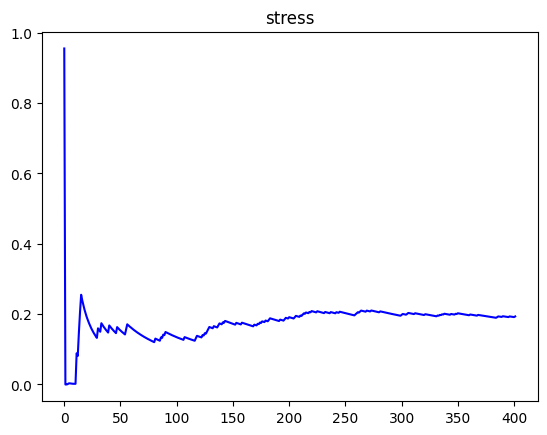

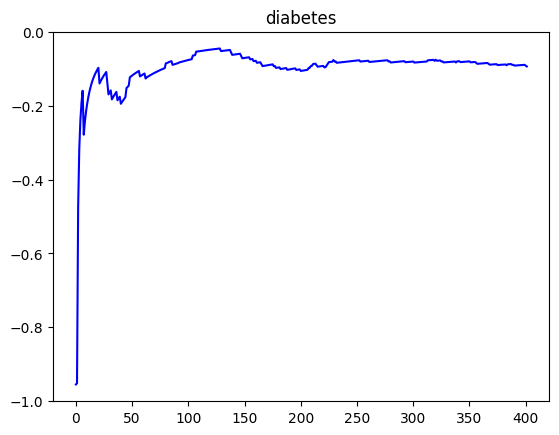

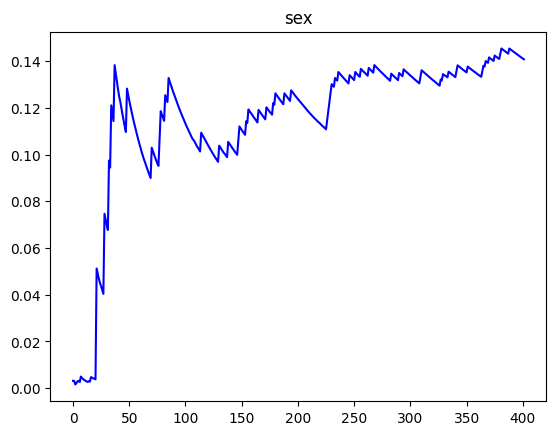

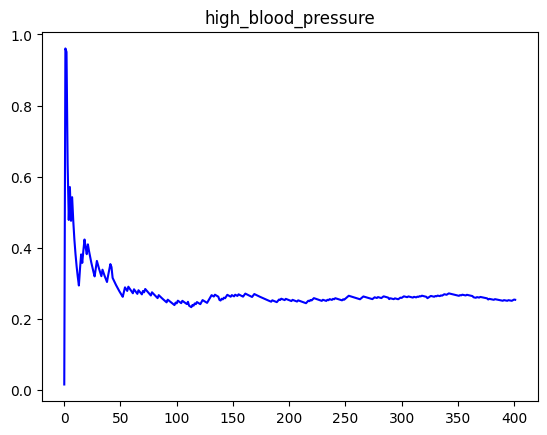

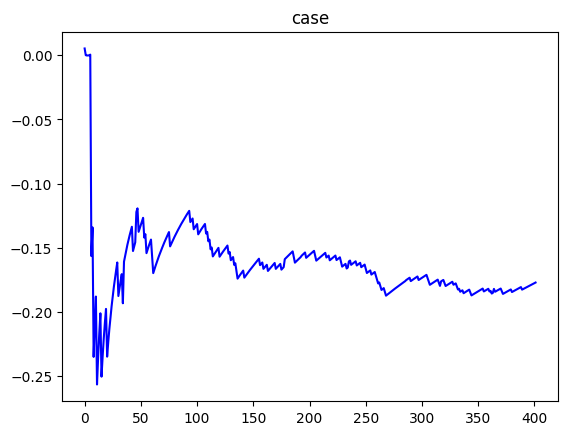

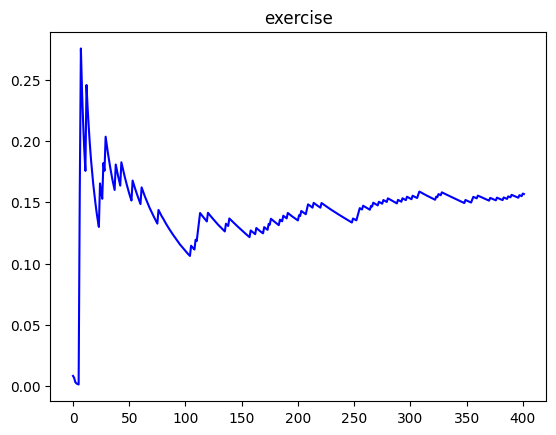

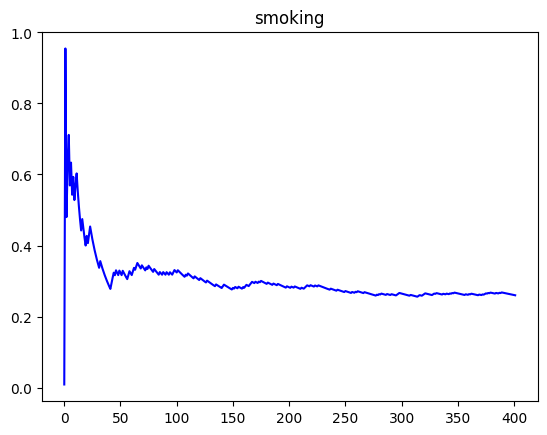

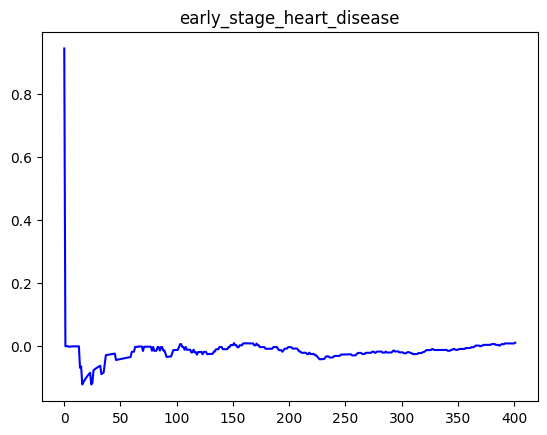

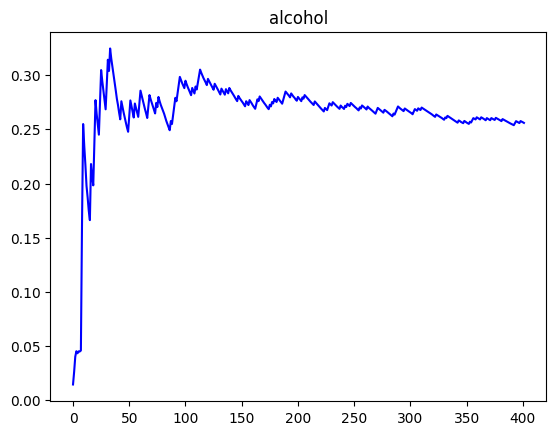

In [465]:
import numpy as np
import matplotlib.pyplot as plt
for item in range(sequential_paf_part.shape[0]):
    x_plt = sequential_paf_part.iloc[item:item+1,:].T.reset_index().drop(['index'],axis=1)
    plt.figure()
    plt.plot(x_plt, linestyle='-', color='blue')
    plt.title(list(x_plt.columns)[0])
    name = list(x_plt.columns)[0]
    
    plt.savefig(name+str(".png"))
#     sequential_paf_part.iloc[item:item+1,:].T.reset_index().drop(['index'],axis=1).plot()

# Doubly robust estimates

In [ ]:
# model_ipw = IPW(treatment,confounder)

In [388]:
def find_multiple_confounder(treatment):
    X_list_total = []
    for item in treatment:
        print(item)
        parent_one = parent[[item]]
        X_list = list(parent_one[parent_one[item]==1].index)
        X_list_total.extend(X_list)
        print("X_list_total",len(X_list_total))
#     X_list_total.extend(treatment) 
    return X_list_total
# model.predict_proba(X_test)

In [389]:
def find_confounder(treatment):
    X_list_total = []
    parent_one = parent[[treatment]]
    X_list = list(parent_one[parent_one[treatment]==1].index)
    X_list_total.extend(X_list)
#         print("X_list_total",len(X_list_total))
#     X_list_total.extend(treatment) 
    return X_list_total
# model.predict_proba(X_test)

In [455]:
def IPW_multiple_treatment(treatment,x,y):
#     x_1 = stroke_reduced_df[stroke_reduced_df[x] == 1]
    if len(x) != 0:
        y_ipw = y
        for item in treatment:
            model2 = LogisticRegression()
            model2.fit(stroke_reduced_df[x], stroke_reduced_df[item])
            probabilities = model2.predict_proba(stroke_reduced_df[x])
#         stroke_reduced_df[y]
#         print("y_ipw",y_ipw.values)
#         print("probabilities",probabilities[:,1])
            y_ipw = y_ipw/(probabilities[:,1])
#     probabilities = model.predict_proba(X_test)
#     x_0 = stroke_reduced_df[stroke_reduced_df[x] == 0]
#     T1_X1 = x_1[x_1[treatment] == 1].shape[0]/x_1.shape[0]
#     T1_X0 = x_0[x_0[treatment] == 1].shape[0]/x_0.shape[0]
    else:
        y_ipw = y
    return y_ipw
   

In [450]:
def IPW(treatment,x,y):
#     x_1 = stroke_reduced_df[stroke_reduced_df[x] == 1]
    if len(x) != 0:
        y_ipw = y
        model2 = LogisticRegression()
        print("看这个",x,treatment)
        model2.fit(stroke_reduced_df[x], stroke_reduced_df[treatment])
        probabilities = model2.predict_proba(stroke_reduced_df[x])
        y_ipw = y_ipw/(probabilities[:,1])
#     probabilities = model.predict_proba(X_test)
#     x_0 = stroke_reduced_df[stroke_reduced_df[x] == 0]
#     T1_X1 = x_1[x_1[treatment] == 1].shape[0]/x_1.shape[0]
#     T1_X0 = x_0[x_0[treatment] == 1].shape[0]/x_0.shape[0]
    else:
        y_ipw = y
    return y_ipw
   

In [451]:
y_ipw = IPW(treatment,find_confounder(treatment),y)

In [384]:
treatment

['exercise', 'case']

# doubly robust-total effect

In [444]:
def doublely_robust_total_effect(y,treatment):
    y_new = outcome(y,treatment)
    print(y_new,treatment)
    y_new_ipw = IPW(treatment,find_confounder(treatment),y_new)
    y_origin = stroke_reduced_df[y]
    y_origin_ipw = IPW(treatment,find_confounder(treatment),y_origin)
    print("result", y_origin_ipw.sum(),y_new_ipw.sum(),y_new.sum(),y_origin.sum())
    return (y_origin_ipw.sum() - y_new_ipw.sum())/y_origin_ipw.sum()

# outcome(y,treatment)

In [452]:
treatment = str('exercise')
y = str('event')
doublely_robust_total_effect(y,treatment)

for item in include_x:
    y = str('event')
    treatment = str(item)
    print(doublely_robust_total_effect(y,treatment),item)
    

['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
1.0 sex
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
0.9624381056827418 stress
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
0.9823987940922855 exercise
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
0.006279665356544322 case
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
0.2986007748814206 early_stage_heart_disease
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
0.96278242519066

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
0.16839763992923984 diabetes
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
0.32180340151397097 high_blood_pressure


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


In [454]:
treatment = str('education')
print(doublely_robust_total_effect(y,treatment),item)
    

[]
0
1
[0. 0. 0. ... 0. 0. 0.] education
result 3836.0 0.0 0.0 3836.0
1.0 high_blood_pressure


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


## doubly robust-sequential paf: multiple p(t=1|x) multiple?

In [429]:
# def doublely_robust_paf(y,treatment):
#     y_new = outcome_multiple_treatments(y,treatment)
#     model_ipw = IPW(treatment,find_confounder(treatment))
# #     stroke_reduced_df[find_confounder(treatment)]
#     ipw_prob = model.predict_proba(stroke_reduced_df[find_confounder(treatment)])
# #     y_new['A'].div(B['C'])

    
# #     y1 = stroke_reduced_df['event']
# #     print(y_new.sum(),y1.sum(),(y1.sum() - y_new.sum())/y1.sum())
# #     return (y1.sum() - y_new.sum())/y1.sum()

  

In [430]:
# k = doublely_robust_total_effect(y,treatment)

In [445]:
doublely_robust_total_effect(y,str(order[0]))

[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
[0. 0. 0. ... 0. 0. 0.]


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


ValueError: at least one array or dtype is required

In [442]:
order

['sex',
 'stress',
 'exercise',
 'case',
 'early_stage_heart_disease',
 'smoking',
 'alcohol',
 'diabetes',
 'high_blood_pressure']

In [439]:

def order_doublyrobust_seqpaf(y,order):
    sequential_paf = []
    print(order)
    for item in range(len(order)):
        if item==0:
            y = str('event')
#             treatment = str(order[item])
            sequential_paf.append([doublely_robust_total_effect(y,str(order[item])),order[item]])
        else:
            print("item",item)
            
            item1 = order[:item]
            item2 = order[:item+1]
            
            new_y1 = outcome_multiple_treatments(y,item1)
            new_y2 = outcome_multiple_treatments(y,item2)
            new_y1 = IPW_multiple_treatment(treatment,find_confounder(treatment),new_y1)
            new_y2 = IPW_multiple_treatment(treatment,find_confounder(treatment),new_y2)
            y_origin = stroke_reduced_df[y]
            y_origin_ipw = IPW_multiple_treatment(treatment,find_confounder(treatment),y_origin)
#             IPW_multiple_treatment(treatment,x,y)
            print(new_y1,new_y2)
            sequential_paf.append([(new_y1.sum()-new_y2.sum())/y_origin_ipw.sum(),order[item]])
    return sequential_paf


In [437]:
# def generate_random_order(order):
#     return random.shuffle(order)


In [466]:
random_times = 400
y = str('event')
order = include_x
sequential_paf_dr = order_doublyrobust_seqpaf(y,order)
sequential_paf_dr = pd.DataFrame(sequential_paf_dr,columns=['score','name'])
sequential_paf_dr.index = sequential_paf_dr['name']
sequential_paf_dr = sequential_paf_dr.drop(['name'],axis=1)
sequential_paf_all_dr = sequential_paf_dr
for item in range(random_times):
    generate_random_order(order)
    sequential_paf_dr = order_doublyrobust_seqpaf(y,order)
    sequential_paf_dr = pd.DataFrame(sequential_paf_dr,columns=['score','name'])
    sequential_paf_dr.index = sequential_paf_dr['name']
    sequential_paf_dr = sequential_paf_dr.drop(['name'],axis=1)
    sequential_paf_all_dr = pd.concat([sequential_paf_all_dr, sequential_paf_dr], axis=1)
    print(sequential_paf_all_dr.shape)
#     print("sequential_paf",sequential_paf)
    

['stress', 'diabetes', 'sex', 'high_blood_pressure', 'case', 'exercise', 'smoking', 'early_stage_heart_disease', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
['case', 'exercise', 'smoking', 'diabetes', 'alcohol', 'stress', 'high_blood_pressure', 'sex', 'early_stage_heart_disease']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 6
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.494

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 4)
['exercise', 'alcohol', 'sex', 'case', 'early_stage_heart_disease', 'diabetes', 'smoking', 'stress', 'high_blood_pressure']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 5)
['alcohol', 'smoking', 'diabetes', 'case', 'early_stage_heart_disease', 'stress', 'exercise', 'sex', 'high_blood_pressure']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 6)
['early_stage_heart_disease', 'alcohol', 'stress', 'high_blood_pressure', 'diabetes', 'case', 'smoking', 'sex', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 7)
['alcohol', 'early_stage_heart_disease', 'stress', 'diabetes', 'exercise', 'high_blood_pressure', 'smoking', 'case', 'sex']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 8)
['smoking', 'alcohol', 'diabetes', 'high_blood_pressure', 'stress', 'sex', 'exercise', 'early_stage_heart_disease', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 9)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.157

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 18
X_list_total 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 11)
['early_stage_heart_disease', 'stress', 'diabetes', 'sex', 'high_blood_pressure', 'smoking', 'alcohol', 'case', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', '

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 12)
['exercise', 'case', 'stress', 'diabetes', 'high_blood_pressure', 'early_stage_heart_disease', 'sex', 'smoking', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 13)
['sex', 'stress', 'alcohol', 'exercise', 'smoking', 'early_stage_heart_disease', 'diabetes', 'high_blood_pressure', 'case']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-6.86468941]
Coefficients: [[1.88115242 2.1430578  6.63343179 0.16269598 1.55199475]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.86468941]
Coefficients: [[1.88115242 2.1430578  6.63343179 0.16269598 1.55199475]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
x shape (13712, 6)
Intercept: [-7.0774622]
Coefficients: [[1.41848557 1.36511728 4.14496734 3.94104152 0.18714789 1.76388174]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
x shape (13712, 6)
Intercept: [-7.0774622]
Coefficients: [[1.41848557 1.36511728 4.14496734 3.94104152 0.18714789 1.76388174]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 22
X_list_total 28
x shape (1371

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 14)
['exe

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 15)
['high_blood_pressure', 'early_stage_heart_disease', 'alcohol', 'sex', 'diabetes', 'case', 'exercise', 'stress', 'smoking']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol',

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 25
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
x shape (

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 16)
['alcohol', 'stress', 'smoking', 'exercise', 'diabetes', 'high_blood_pressure', 'case', 'sex', 'early_stage_heart_disease']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 3


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.00507676]
Coefficients: [[1.21124394 4.61190789 4.56134286 0.15012065 2.15106516]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 19
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 19
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 19
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 13
X_list_total 19
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 17)
['smoking', 'exercise', 'high_blood_pressure', 'sex', 'diabetes', 'early_stage_heart_disease', 'case', 'alcohol', 'stress']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 8
x

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients:

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_l

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
x shape (13712

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 19)
['exercise', 'smoking', 'early_stage_heart_disease', 'stress', 'sex', 'alcohol', 'diabetes', 'case', 'high_blood_pressure']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 11

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 20)
['smoking', 'early_stage_heart_disease', 'case', 'stress', 'exercise', 'diabetes', 'alcohol', 'high_blood_pressure', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coef

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 21)
['early_stage_heart_disease', 'sex', 'smoking', 'alcohol', 'high_blood_pressure', 'case', 'diabetes', 'stress', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
x sh

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.95483459]
Coefficients: [[5.0326992  5.02867035 2.37905901 0.14930219]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.95483459]
Coefficients: [[5.0326992  5.02867035 2.37905901 0.14930219]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.792

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123068

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 6
X_list_total 17
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 25)
['case', 'high_blood_pressure', 'diabetes', 'smoking', 'early_stage_heart_disease', 'sex', 'alcohol', 'exercise', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', '

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
x shape 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 26)
['high_blood_pressure', 'smoking', 'exercise', 'diabetes', 'early_stage_heart_disease', 'alcohol', 'case', 'sex', 'stress']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol'

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.114948

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 29
x shape (

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 28)
['sex', 'exercise', 'early_stage_heart_disease', 'high_blood_pressure', 'alcohol', 'case', 'stress', 'diabetes', 'smoking']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 32
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 30)
['smoking', 'sex', 'case', 'alcohol', 'early_stage_heart_disease', 'high_blood_pressure', 'stress', 'exercise', 'diabetes']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 31)
['early_stage_heart_disease', 'case', 'high_blood_pressure', 'stress', 'smoking', 'diabetes', 'exercise', 'sex', 'alcohol']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.642

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 20


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 32)
['alcohol', 'smoking', 'early_stage_heart_disease', 'sex', 'high_blood_pressure', 'diabetes', 'stress', 'exercise', 'case']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.010021

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.494005

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 33)
['diabetes', 'early_stage_heart_disease', 'exercise', 'stress', 'high_blood_pressure', 'case', 'smoking', 'alcohol', 'sex']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_bloo

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.568

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 18
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 34)
['smoking', 'case', 'exercise', 'diabetes', 'alcohol', 'sex', 'early_stage_heart_disease', 'high_blood_pressure', 'stress']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 35)
['alcohol', 'case', 'exercise', 'high_blood_pressure', 'sex', 'diabetes', 'stress', 'smoking', 'early_stage_heart_disease']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 27
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 38)
['alcohol', 'exercise', 'high_blood_pressure', 'diabetes', 'early_stage_heart_disease', 'stress', 'case', 'smoking', 'sex']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.010021

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
x

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficient

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 39)
['stress', 'smoking', 'diabetes', 'high_blood_pressure', 'case', 'exercise', 'sex', 'early_stage_heart_disease', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 11
x sha

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.455

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 41)
['high_blood_pressure', 'alcohol', 'diabetes', 'exercise', 'case', 'stress', 'smoking', 'early_stage_heart_disease', 'sex']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 43)
['high_blood_pressure', 'alcohol', 'smoking', 'case', 'stress', 'diabetes', 'sex', 'exercise', 'early_stage_heart_disease']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 44)
['diabetes', 'stress', 'alcohol', 'high_blood_pressure', 'smoking', 'case', 'sex', 'early_stage_heart_disease', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 45)
['stress', 'diabetes', 'alcohol', 'smoking', 'high_blood_pressure', 'exercise', 'sex', 'case', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 47)
['alcohol', 'sex', 'exercise', 'stress', 'diabetes', 'smoking', 'early_stage_heart_disease', 'case', 'high_blood_pressure']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 1
X_list_total 1
X_list_total 2


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.86468941]
Coefficients: [[1.88115242 2.1430578  6.63343179 0.16269598 1.55199475]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.86468941]
Coefficients: [[1.88115242 2.1430578  6.63343179 0.16269598 1.55199475]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_to

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 22

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 49)
['high_blood_pressure', 'early_stage_heart_disease', 'exercise', 'smoking', 'stress', 'diabetes', 'alcohol', 'case', 'sex']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 50)
['smoking', 'exercise', 'alcohol', 'early_stage_heart_disease', 'sex', 'high_blood_pressure', 'stress', 'diabetes', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 3
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 51)
['stress', 'exercise', 'case', 'alcohol', 'diabetes', 'high_blood_pressure', 'sex', 'smoking', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 13
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 52)
['sex', 'stress', 'smoking', 'case', 'exercise', 'alcohol', 'early_stage_heart_disease', 'high_blood_pressure', 'diabetes']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
[0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 15
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 15
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 54)
['stress', 'alcohol', 'exercise', 'case', 'early_stage_heart_disease', 'high_blood_pressure', 'smoking', 'diabetes', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 55)
['early_stage_heart_disease', 'case', 'high_blood_pressure', 'smoking', 'stress', 'exercise', 'sex', 'alcohol', 'diabetes']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'educati

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.4128638

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 56)
['smoking', 'high_blood_pressure', 'case', 'exercise', 'stress', 'diabetes', 'sex', 'early_stage_heart_disease', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.5

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 57)
['stress', 'diabetes', 'alcohol', 'case', 'early_stage_heart_disease', 'high_blood_pressure', 'smoking', 'sex', 'exercise']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 58)
['alcohol', 'case', 'early_stage_heart_disease', 'high_blood_pressure', 'smoking', 'diabetes', 'stress', 'exercise', 'sex']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.010021

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 59)
['stress', 'case', 'diabetes', 'high_blood_pressure', 'sex', 'smoking', 'alcohol', 'exercise', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123068

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 60)
['alcohol', 'case', 'stress', 'sex', 'diabetes', 'smoking', 'exercise', 'high_blood_pressure', 'early_stage_heart_disease']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 14
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 29
x sh

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 62)
['alcohol', 'stress', 'exercise', 'smoking', 'sex', 'early_stage_heart_disease', 'diabetes', 'case', 'high_blood_pressure']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.0774622]
Coefficients: [[1.41848557 1.36511728 4.14496734 3.94104152 0.18714789 1.76388174]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
x shape (13712, 6)
Intercept: [-7.0774622]
Coefficients: [[1.41848557 1.36511728 4.14496734 3.94104152 0.18714789 1.76388174]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
X_list_total 22
X_list_total 33
x shape (1371

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
X_list_total 22
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 6

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.4078522

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 28
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 65)
['exercise', 'early_stage_heart_disease', 'diabetes', 'alcohol', 'stress', 'case', 'high_blood_pressure', 'smoking', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 38
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 6

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 68)
['high_blood_pressure', 'diabetes', 'early_stage_heart_disease', 'sex', 'case', 'exercise', 'stress', 'smoking', 'alcohol']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'ed

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 15
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 24
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 24
X_list_total 35
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 24
X_list_total 35
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 24
X_list_total 35
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 24
X_list_total 35
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 24
X_list_total 35
X_list_total 36
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 24
X_list_total 35
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 24
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 24
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 69)
['early_stage_heart_disease', 'high_blood_pressure', 'stress', 'exercise', 'diabetes', 'alcohol', 'smoking', 'sex', 'case']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', '

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coeff

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 70)
['stress', 'exercise', 'case', 'diabetes', 'smoking', 'high_blood_pressure', 'early_stage_heart_disease', 'alcohol', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 71)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 72)
['smoking', 'high_blood_pressure', 'sex', 'exercise', 'case', 'alcohol', 'early_stage_heart_disease', 'stress', 'diabetes']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.5

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.240529

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 7

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 75)
['stress', 'smoking', 'early_stage_heart_disease', 'sex', 'exercise', 'diabetes', 'alcohol', 'high_blood_pressure', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 11
x shap

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.494005

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 76)
['high_blood_pressure', 'stress', 'exercise', 'smoking', 'early_stage_heart_disease', 'case', 'diabetes', 'sex', 'alcohol']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.498858

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

(10, 77)
['diabetes', 'alcohol', 'case', 'sex', 'stress', 'high_blood_pressure', 'smoking', 'early_stage_heart_disease', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 28
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Interce

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coeffici

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_82

[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 33
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 80)
['high_blood_pressure', 'diabetes', 'stress', 'case', 'early_stage_heart_disease', 'smoking', 'sex', 'exercise', 'alcohol']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 81)
['high_blood_pressure', 'exercise', 'stress', 'diabetes', 'sex', 'smoking', 'alcohol', 'early_stage_heart_disease', 'case']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 82)
[

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
x shape (13712, 5)
Intercept: [-7.00507676]
Coefficients: [[1.21124394 4.61190789 4.56134286 0.15012065 2.15106516]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
x shape (13712, 5)
Intercept: [-7.00507676]
Coefficients: [[1.21124394 4.61190789 4.56134286 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 83)
['sex', 'smoking', 'early_stage_heart_disease', 'exercise', 'high_blood_pressure', 'alcohol', 'stress', 'diabetes', 'case']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.163159

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 84)

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
x shap

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 85)
['smoking', 'exercise', 'diabetes', 'high_blood_pressure', 'alcohol', 'stress', 'case', 'early_stage_heart_disease', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 11


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 86)
['smoking', 'early_stage_heart_disease', 'stress', 'diabetes', 'case', 'high_blood_pressure', 'exercise', 'alcohol', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 8

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 89)
['early_stage_heart_disease', 'smoking', 'alcohol', 'diabetes', 'case', 'stress', 'sex', 'high_blood_pressure', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 91)
['diabetes', 'alcohol', 'smoking', 'sex', 'stress', 'early_stage_heart_disease', 'exercise', 'high_blood_pressure', 'case']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'educati

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 9

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 93)
['exercise', 'case', 'stress', 'early_stage_heart_disease', 'high_blood_pressure', 'alcohol', 'smoking', 'sex', 'diabetes']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 96

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.832151

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 97)
['alcohol', 'sex', 'smoking', 'early_stage_heart_disease', 'case', 'high_blood_pressure', 'stress', 'exercise', 'diabetes']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.73133439]
Coefficients: [[8.48987922 1.3611569  2.10162855 0.16249154]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[8.48987922 1.3611569  2.10162855 0.16249154]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 98)
['diabetes', 'high_blood_pressure', 'early_stage_heart_disease', 'smoking', 'exercise', 'alcohol', 'sex', 'stress', 'case']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 15
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 15
X_list_total 24
x sha

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.4078522

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.118447

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 12
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 100)
['smoking', 'high_blood_pressure', 'diabetes', 'stress', 'sex', 'exercise', 'alcohol', 'early_stage_heart_disease', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_to

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 101)
['exercise', 'sex', 'high_blood_pressure', 'early_stage_heart_disease', 'diabetes', 'alcohol', 'smoking', 'case', 'stress']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 102)
['smoking', 'high_blood_pressure', 'exercise', 'case', 'diabetes', 'sex', 'stress', 'early_stage_heart_disease', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 103)
['sex', 'high_blood_pressure', 'stress', 'alcohol', 'early_stage_heart_disease', 'smoking', 'exercise', 'case', 'diabetes']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 0
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 17
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 105)
['high_blood_pressure', 'stress', 'exercise', 'diabetes', 'alcohol', 'case', 'sex', 'early_stage_heart_disease', 'smoking']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 106)
['smoking', 'exercise', 'high_blood_pressure', 'case', 'diabetes', 'sex', 'early_stage_heart_disease', 'stress', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 107)
['high_blood_pressure', 'sex', 'smoking', 'exercise', 'diabetes', 'stress', 'early_stage_heart_disease', 'case', 'alcohol']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 6
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 108)
['stress', 'alcohol', 'exercise', 'case', 'smoking', 'early_stage_heart_disease', 'high_blood_pressure', 'diabetes', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.296

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.4991

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 109)
[

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 110)
['alcohol', 'diabetes', 'smoking', 'sex', 'high_blood_pressure', 'case', 'early_stage_heart_disease', 'stress', 'exercise']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.010021

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 112)
['alcohol', 'smoking', 'sex', 'high_blood_pressure', 'case', 'exercise', 'stress', 'early_stage_heart_disease', 'diabetes']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.73133439]
Coefficients: [[1.3611569  8.48987922 2.10162855 0.16249154]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[1.3611569  8.48987922 2.10162855 0.16249154]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
x shape

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 113)
['diabetes', 'early_stage_heart_disease', 'smoking', 'alcohol', 'high_blood_pressure', 'stress', 'case', 'exercise', 'sex']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education',

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 4.7408766  1.11583665 3.24203175]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 4.7408766  1.11583665 3.24203175]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (1371

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 115)
['stress', 'diabetes', 'smoking', 'sex', 'exercise', 'alcohol', 'high_blood_pressure', 'early_stage_heart_disease', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.29

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 117)
['stress', 'case', 'smoking', 'high_blood_pressure', 'diabetes', 'sex', 'alcohol', 'early_stage_heart_disease', 'exercise']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 118)
['high_blood_pressure', 'early_stage_heart_disease', 'sex', 'alcohol', 'exercise', 'case', 'stress', 'diabetes', 'smoking']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol'

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 15
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 119)
['exercise', 'alcohol', 'sex', 'high_blood_pressure', 'smoking', 'early_stage_heart_disease', 'case', 'diabetes', 'stress']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
X_list_total 1
X_list_total 2
X_list_total 2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercep

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.232188

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 8
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.4991

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 122)
['exercise', 'smoking', 'diabetes', 'high_blood_pressure', 'alcohol', 'case', 'sex', 'stress', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 11

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 123)
['diabetes', 'alcohol', 'case', 'exercise', 'sex', 'high_blood_pressure', 'early_stage_heart_disease', 'stress', 'smoking']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'educati

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 124)
['high_blood_pressure', 'diabetes', 'case', 'sex', 'alcohol', 'smoking', 'exercise', 'stress', 'early_stage_heart_disease']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 15
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 15
X_list_total 26
X_list_total 26
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 15
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 15
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 15
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 125)
['sex', 'case', 'high_blood_pressure', 'early_stage_heart_disease', 'smoking', 'stress', 'alcohol', 'diabetes', 'exercise']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.703151

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 11
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 11
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 126)
['alcohol', 'case', 'stress', 'smoking', 'high_blood_pressure', 'exercise', 'early_stage_heart_disease', 'sex', 'diabetes']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Inte

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 127)
['exercise', 'case', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'high_blood_pressure', 'stress', 'sex', 'smoking']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.0946944

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 18
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 18
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

(10, 129)
['early_stage_heart_disease', 'exercise', 'stress', 'high_blood_pressure', 'case', 'sex', 'alcohol', 'smoking', 'diabetes']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 29
x shape (

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 130)
['early_stage_heart_disease', 'sex', 'high_blood_pressure', 'smoking', 'alcohol', 'exercise', 'diabetes', 'case', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_to

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 131)
['sex', 'alcohol', 'early_stage_heart_disease', 'exercise', 'case', 'smoking', 'stress', 'diabetes', 'high_blood_pressure']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 0
X_list_total 6
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 6
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 6
X_list_total 17
X_list_total 26
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 6
X_list_total 17
X_list_total 26
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 6
X_list_total 17
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 136)
['diabetes', 'case', 'exercise', 'sex', 'high_blood_pressure', 'early_stage_heart_disease', 'alcohol', 'smoking', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'educati

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 36
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 137)
['exercise', 'case', 'high_blood_pressure', 'diabetes', 'alcohol', 'sex', 'stress', 'early_stage_heart_disease', 'smoking']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 138)
['sex', 'stress', 'exercise', 'smoking', 'case', 'diabetes', 'alcohol', 'high_blood_pressure', 'early_stage_heart_disease']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.29325594]
Coefficients: [[2.37355252 2.78196486 3.4820502  2.66485272 1.17276832]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 0
X_list_total 1
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 139)
['exercise', 'stress', 'diabetes', 'high_blood_pressure', 'early_stage_heart_disease', 'smoking', 'alcohol', 'sex', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 11

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 140)
['stress', 'diabetes', 'smoking', 'alcohol', 'sex', 'case', 'early_stage_heart_disease', 'exercise', 'high_blood_pressure']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficie

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
X_list_total 1
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 143)
['stress', 'smoking', 'case', 'diabetes', 'sex', 'high_blood_pressure', 'early_stage_heart_disease', 'exercise', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 144)
['exercise', 'stress', 'smoking', 'case', 'diabetes', 'early_stage_heart_disease', 'sex', 'high_blood_pressure', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 3


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 145)
['high_blood_pressure', 'smoking', 'diabetes', 'case', 'stress', 'exercise', 'sex', 'alcohol', 'early_stage_heart_disease']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 147)
['sex', 'early_stage_heart_disease', 'high_blood_pressure', 'stress', 'case', 'diabetes', 'smoking', 'exercise', 'alcohol']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.2297830

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 148)
['early_stage_heart_disease', 'exercise', 'smoking', 'stress', 'case', 'high_blood_pressure', 'alcohol', 'sex', 'diabetes']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 149)
['exercise', 'early_stage_heart_disease', 'alcohol', 'high_blood_pressure', 'smoking', 'case', 'sex', 'stress', 'diabetes']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Co

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.3387090

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 150)
['diabetes', 'smoking', 'early_stage_heart_disease', 'case', 'high_blood_pressure', 'exercise', 'sex', 'alcohol', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'educat

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 36
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.494

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 153)
['case', 'smoking', 'sex', 'early_stage_heart_disease', 'high_blood_pressure', 'diabetes', 'stress', 'alcohol', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 154)
['high_blood_pressure', 'exercise', 'smoking', 'case', 'sex', 'diabetes', 'stress', 'early_stage_heart_disease', 'alcohol']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficient

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 6
X_list_total 7
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.85967

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.95483459]
Coefficients: [[5.0326992  5.02867035 2.37905901 0.14930219]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.95483459]
Coefficients: [[5.0326992  5.02867035 2.37905901 0.14930219]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.5

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 12)

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 157)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 9
X_list_total 18
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.17165281]
Coefficients: [[2.75474016 4.7408766  1.11583665 3.24203175]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 4.7408766  1.11583665 3.24203175]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (1371

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 0
X_list_total 1
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 13)
Int

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 164)
['diabetes', 'high_blood_pressure', 'case', 'alcohol', 'sex', 'early_stage_heart_disease', 'exercise', 'stress', 'smoking']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 15
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 165)
['stress', 'case', 'smoking', 'sex', 'diabetes', 'early_stage_heart_disease', 'alcohol', 'high_blood_pressure', 'exercise']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 166)
['early_stage_heart_disease', 'sex', 'case', 'diabetes', 'alcohol', 'high_blood_pressure', 'stress', 'smoking', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 9
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 167)
['smoking', 'high_blood_pressure', 'alcohol', 'exercise', 'case', 'sex', 'stress', 'diabetes', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 168)
['exercise', 'smoking', 'alcohol', 'high_blood_pressure', 'sex', 'stress', 'case', 'early_stage_heart_disease', 'diabetes']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 3


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)
Intercept

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 170)
['case', 'alcohol', 'high_blood_pressure', 'exercise', 'smoking', 'stress', 'sex', 'diabetes', 'early_stage_heart_disease']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 171)
['stress', 'exercise', 'diabetes', 'high_blood_pressure', 'early_stage_heart_disease', 'alcohol', 'case', 'sex', 'smoking']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.114

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 38
x sh

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 173)
['stress', 'early_stage_heart_disease', 'smoking', 'sex', 'exercise', 'alcohol', 'case', 'high_blood_pressure', 'diabetes']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 174)
['high_blood_pressure', 'sex', 'early_stage_heart_disease', 'exercise', 'case', 'stress', 'alcohol', 'diabetes', 'smoking']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 6
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 6
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 175)
['early_stage_heart_disease', 'alcohol', 'high_blood_pressure', 'stress', 'case', 'diabetes', 'sex', 'exercise', 'smoking']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.6

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 0
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 37
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 177)
['sex', 'case', 'exercise', 'early_stage_heart_disease', 'high_blood_pressure', 'stress', 'smoking', 'alcohol', 'diabetes']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 178)
['case', 'high_blood_pressure', 'smoking', 'exercise', 'diabetes', 'sex', 'stress', 'early_stage_heart_disease', 'alcohol']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.118447

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 11
X_list_total 17
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 179)
['alcohol', 'stress', 'high_blood_pressure', 'exercise', 'diabetes', 'early_stage_heart_disease', 'case', 'sex', 'smoking']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 8


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 180)
['high_blood_pressure', 'sex', 'stress', 'case', 'smoking', 'alcohol', 'exercise', 'early_stage_heart_disease', 'diabetes']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol',

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 6
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1.01271031]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1.01271031]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 182)
['stress', 'diabetes', 'smoking', 'exercise', 'case', 'early_stage_heart_disease', 'high_blood_pressure', 'alcohol', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712,

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 8
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 0
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 0
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 185)
['early_stage_heart_disease', 'sex', 'case', 'high_blood_pressure', 'stress', 'smoking', 'diabetes', 'exercise', 'alcohol']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 26
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 186)
['diabetes', 'alcohol', 'sex', 'high_blood_pressure', 'stress', 'case', 'smoking', 'early_stage_heart_disease', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 10
x sha

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 187)
['exercise', 'sex', 'alcohol', 'early_stage_heart_disease', 'smoking', 'stress', 'high_blood_pressure', 'diabetes', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 1
X_list_total 1
X_list_total 2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 188)
['case', 'sex', 'diabetes', 'smoking', 'early_stage_heart_disease', 'alcohol', 'high_blood_pressure', 'exercise', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'di

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 11
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 11
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
X_list_total 1
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.1826

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 16
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 190)
['high_blood_pressure', 'smoking', 'alcohol', 'diabetes', 'case', 'exercise', 'sex', 'early_stage_heart_disease', 'stress']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 191)
['high_blood_pressure', 'diabetes', 'smoking', 'stress', 'early_stage_heart_disease', 'alcohol', 'sex', 'exercise', 'case']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

item 4
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 193)
['smoking', 'exercise', 'stress', 'alcohol', 'sex', 'diabetes', 'early_stage_heart_disease', 'high_blood_pressure', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 3


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
X_list_total 22
x 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 4
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 194)
['ex

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 195)
['exercise', 'stress', 'early_stage_heart_disease', 'smoking', 'alcohol', 'high_blood_pressure', 'diabetes', 'sex', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 196)
['high_blood_pressure', 'exercise', 'stress', 'sex', 'early_stage_heart_disease', 'diabetes', 'smoking', 'case', 'alcohol']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'ed

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.538933

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
x shape

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 198)
['smoking', 'case', 'alcohol', 'high_blood_pressure', 'diabetes', 'stress', 'early_stage_heart_disease', 'sex', 'exercise']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123068

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_to

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 20
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.118375

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 20
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 203)
['high_blood_pressure', 'sex', 'case', 'early_stage_heart_disease', 'alcohol', 'stress', 'smoking', 'diabetes', 'exercise']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 6
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 6
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 17
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 204)
['sex', 'case', 'smoking', 'diabetes', 'stress', 'alcohol', 'early_stage_heart_disease', 'exercise', 'high_blood_pressure']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.7031517

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 11
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 205)
['sex', 'diabetes', 'exercise', 'stress', 'alcohol', 'early_stage_heart_disease', 'case', 'smoking', 'high_blood_pressure']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.494005

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 206)
['alcohol', 'smoking', 'early_stage_heart_disease', 'case', 'diabetes', 'sex', 'stress', 'high_blood_pressure', 'exercise']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 31
X_list_total 32
x shape (137

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 3.24203175 4.7408766  1.11583665]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 3.24203175 4.7408766  1.11583665]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (1371

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 208)
['smoking', 'high_blood_pressure', 'early_stage_heart_disease', 'stress', 'exercise', 'diabetes', 'alcohol', 'sex', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.6

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.339

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 210)

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 211)
['stress', 'case', 'high_blood_pressure', 'alcohol', 'exercise', 'early_stage_heart_disease', 'diabetes', 'smoking', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.296984

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 21

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 213)
['stress', 'high_blood_pressure', 'case', 'sex', 'early_stage_heart_disease', 'smoking', 'diabetes', 'alcohol', 'exercise']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
x shape (13

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 214)
['sex', 'stress', 'alcohol', 'smoking', 'case', 'early_stage_heart_disease', 'exercise', 'diabetes', 'high_blood_pressure']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 215)
['sex', 'stress', 'high_blood_pressure', 'case', 'alcohol', 'diabetes', 'smoking', 'exercise', 'early_stage_heart_disease']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.98180573]
Coefficients: [[6.170

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1.01271031]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 9
X_list_total 10
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 218)
['case', 'sex', 'alcohol', 'high_blood_pressure', 'smoking', 'early_stage_heart_disease', 'diabetes', 'stress', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'd

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 11
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.437672

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 220)
['diabetes', 'early_stage_heart_disease', 'high_blood_pressure', 'exercise', 'smoking', 'sex', 'alcohol', 'stress', 'case']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.6179

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.4078522

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 18
X_list_total 2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 221)
['early_stage_heart_disease', 'case', 'alcohol', 'diabetes', 'high_blood_pressure', 'stress', 'sex', 'smoking', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'edu

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 222)
['smoking', 'diabetes', 'high_blood_pressure', 'exercise', 'case', 'sex', 'early_stage_heart_disease', 'stress', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.621166

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 223)
['exercise', 'stress', 'smoking', 'alcohol', 'high_blood_pressure', 'diabetes', 'early_stage_heart_disease', 'sex', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.00507676]
Coefficients: [[1.21124394 4.61190789 4.56134286 0.15012065 2.15106516]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
X_list_total 19
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
X_list_total 19
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 10

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 224)
['stress', 'diabetes', 'smoking', 'sex', 'case', 'alcohol', 'high_blood_pressure', 'exercise', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficie

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 225)
['alcohol', 'exercise', 'high_blood_pressure', 'smoking', 'early_stage_heart_disease', 'case', 'stress', 'diabetes', 'sex']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
X_list_total 1
X_list_total 2
X_list_total 8

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 8
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 226)
['smoking', 'case', 'stress', 'early_stage_heart_disease', 'high_blood_pressure', 'exercise', 'sex', 'diabetes', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123068

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 227)
['alcohol', 'high_blood_pressure', 'smoking', 'early_stage_heart_disease', 'diabetes', 'sex', 'stress', 'exercise', 'case']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 228)
['alcohol', 'high_blood_pressure', 'stress', 'sex', 'early_stage_heart_disease', 'exercise', 'smoking', 'case', 'diabetes']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 229)
['early_stage_heart_disease', 'sex', 'exercise', 'case', 'smoking', 'diabetes', 'alcohol', 'high_blood_pressure', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
C

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 230)
['diabetes', 'sex', 'case', 'alcohol', 'high_blood_pressure', 'stress', 'smoking', 'exercise', 'early_stage_heart_disease']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'educati

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 231)
['early_stage_heart_disease', 'diabetes', 'alcohol', 'exercise', 'smoking', 'case', 'stress', 'high_blood_pressure', 'sex']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', '

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
x shape (13712, 12)
Intercept: [-8.568

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 18
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 232)
['smoking', 'alcohol', 'high_blood_pressure', 'stress', 'diabetes', 'sex', 'case', 'exercise', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 8


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 234)
['diabetes', 'high_blood_pressure', 'sex', 'case', 'alcohol', 'stress', 'smoking', 'exercise', 'early_stage_heart_disease']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_bl

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 26
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 26
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 26
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 26
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

item 8
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 235)
['diabetes', 'smoking', 'case', 'high_blood_pressure', 'alcohol', 'early_stage_heart_disease', 'exercise', 'sex', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 37
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 238)
['sex', 'high_blood_pressure', 'exercise', 'case', 'alcohol', 'diabetes', 'stress', 'early_stage_heart_disease', 'smoking']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 0
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x sh

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 239)
['early_stage_heart_disease', 'exercise', 'diabetes', 'case', 'smoking', 'alcohol', 'sex', 'stress', 'high_blood_pressure']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 19
x 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.2451441

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 240)
['exercise', 'case', 'early_stage_heart_disease', 'smoking', 'diabetes', 'sex', 'stress', 'high_blood_pressure', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 31
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.118447

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 32
x shape 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 242)
['smoking', 'high_blood_pressure', 'early_stage_heart_disease', 'sex', 'case', 'diabetes', 'stress', 'alcohol', 'exercise']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.5

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.152608

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coeff

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 246)
['high_blood_pressure', 'diabetes', 'sex', 'exercise', 'stress', 'case', 'smoking', 'early_stage_heart_disease', 'alcohol']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol',

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 6
X_list_total 15
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.73133439]
Coefficients: [[1.3611569  8.48987922 2.10162855 0.16249154]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[1.3611569  8.48987922 2.10162855 0.16249154]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.82573735]
Coefficients: [[1.62091871 1.67837729 7.09348203 0.14765884 1.75869661]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.82573735]
Coefficients: [[1.62091871 1.67837729 7.09348203 0.14765884 1.75869661]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
x shape

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 248)
['case', 'alcohol', 'sex', 'high_blood_pressure', 'early_stage_heart_disease', 'exercise', 'smoking', 'stress', 'diabetes']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.7990

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 20
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 17
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 17
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 251)
['case', 'exercise', 'high_blood_pressure', 'diabetes', 'smoking', 'early_stage_heart_disease', 'sex', 'stress', 'alcohol']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 252)
['stress', 'smoking', 'alcohol', 'case', 'high_blood_pressure', 'sex', 'diabetes', 'exercise', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.95483459]
Coefficients: [[5.0326992  5.02867035 2.37905901 0.14930219]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.95483459]
Coefficients: [[5.0326992  5.02867035 2.37905901 0.14930219]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.7990

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 20
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 253)
['smoking', 'early_stage_heart_disease', 'sex', 'high_blood_pressure', 'stress', 'diabetes', 'case', 'exercise', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 254)
['exercise', 'alcohol', 'sex', 'stress', 'diabetes', 'smoking', 'high_blood_pressure', 'case', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-6.86468941]
Coefficients: [[1.88115242 2.1430578  6.63343179 0.16269598 1.55199475]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.86468941]
Coefficients: [[1.88115242 2.1430578  6.63343179 0.16269598 1.55199475]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_to

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 19
x shape (13

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 255)
['early_stage_heart_disease', 'stress', 'diabetes', 'high_blood_pressure', 'case', 'exercise', 'alcohol', 'smoking', 'sex']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 25
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 7
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.78063215]
Coefficients: [[4.54782165 4.95431856 2.17251745]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.29325594]
Coefficients: [[2.37355252 2.78196486 3.4820502  2.66485272 1.17276832]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.29325594]
Coefficients: [[2.37355252 2.78196486 3.4820502  2.66485272 1.17276832]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_tot

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 259)
['alcohol', 'early_stage_heart_disease', 'case', 'sex', 'diabetes', 'stress', 'exercise', 'high_blood_pressure', 'smoking']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.3551471

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 260)
['high_blood_pressure', 'smoking', 'case', 'exercise', 'early_stage_heart_disease', 'sex', 'alcohol', 'stress', 'diabetes']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 18
X

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 262)
['high_blood_pressure', 'sex', 'diabetes', 'stress', 'smoking', 'alcohol', 'exercise', 'early_stage_heart_disease', 'case']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 6
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 263

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.3947065

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 266)
['case', 'high_blood_pressure', 'diabetes', 'sex', 'alcohol', 'stress', 'smoking', 'exercise', 'early_stage_heart_disease']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 26
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 26
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 267)
['diabetes', 'case', 'high_blood_pressure', 'stress', 'smoking', 'sex', 'alcohol', 'exercise', 'early_stage_heart_disease']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'educati

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 20
X_list_total 26
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 20
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 268)
['sex', 'exercise', 'case', 'alcohol', 'stress', 'high_blood_pressure', 'early_stage_heart_disease', 'smoking', 'diabetes']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 0
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.106058

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 12
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 269)
['sex', 'smoking', 'diabetes', 'case', 'exercise', 'high_blood_pressure', 'stress', 'early_stage_heart_disease', 'alcohol']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.182641

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.4607586

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 272)
['alcohol', 'smoking', 'diabetes', 'case', 'stress', 'high_blood_pressure', 'early_stage_heart_disease', 'exercise', 'sex']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 273)
['early_stage_heart_disease', 'smoking', 'high_blood_pressure', 'alcohol', 'case', 'exercise', 'diabetes', 'sex', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'educ

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 274)
['smoking', 'case', 'stress', 'diabetes', 'exercise', 'alcohol', 'sex', 'early_stage_heart_disease', 'high_blood_pressure']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.621166

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.4

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.494005

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 276)
['high_blood_pressure', 'smoking', 'stress', 'early_stage_heart_disease', 'sex', 'case', 'diabetes', 'alcohol', 'exercise']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 13)
Interce

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 8
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 277)
['early_stage_heart_disease', 'alcohol', 'diabetes', 'sex', 'smoking', 'stress', 'high_blood_pressure', 'exercise', 'case']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.6

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 27
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 278)
['stress', 'alcohol', 'high_blood_pressure', 'early_stage_heart_disease', 'case', 'exercise', 'diabetes', 'sex', 'smoking']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 279)
['smoking', 'high_blood_pressure', 'case', 'diabetes', 'alcohol', 'stress', 'sex', 'early_stage_heart_disease', 'exercise']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58626

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 280)
['sex', 'alcohol', 'exercise', 'diabetes', 'stress', 'case', 'high_blood_pressure', 'smoking', 'early_stage_heart_disease']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.27107899]
Coefficients: [[5.13263304 5.47178947 0.3975561  0.13561221]]
[

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.98180573]
Coefficients: [[6.17056565 4.16029935 1.25958538]]
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 0
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 0
X_list_total 1
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 283)
['stress', 'exercise', 'high_blood_pressure', 'smoking', 'sex', 'early_stage_heart_disease', 'case', 'diabetes', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 9
x shape (13712, 8)
Intercept: [-7.5

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 9
X_list_total 18
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 8
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 10
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73952796]
Coefficients: [[8.3105203  1.53902884 2.18219149 0.10282646]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)
Intercept: [-8.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1.01271031]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 1
X_list_total 2
x shape (13712, 4)
Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1.01271031]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 15
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 287)
['stress', 'exercise', 'sex', 'case', 'high_blood_pressure', 'alcohol', 'early_stage_heart_disease', 'smoking', 'diabetes']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 2
x shap

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coeffici

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 288)
['smoking', 'diabetes', 'sex', 'stress', 'early_stage_heart_disease', 'case', 'exercise', 'high_blood_pressure', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 10
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 290)
['sex', 'alcohol', 'diabetes', 'high_blood_pressure', 'case', 'smoking', 'stress', 'early_stage_heart_disease', 'exercise']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.52664076]
Coefficients: [[8.42366807 0.70156759 0.51592854]]
X_list_total 0
X_list_total 1
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 291)
['exercise', 'case', 'diabetes', 'smoking', 'stress', 'high_blood_pressure', 'alcohol', 'early_stage_heart_disease', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.094694

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 29

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[1.3611569  8.48987922 2.10162855 0.16249154]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.73133439]
Coefficients: [[1.3611569  8.48987922 2.10162855 0.16249154]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.82573735]
Coefficients: [[1.62091871 1.67837729 7.09348203 0.14765884 1.75869661]

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 294)
['

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 16
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 295)
['early_stage_heart_disease', 'alcohol', 'high_blood_pressure', 'diabetes', 'exercise', 'case', 'smoking', 'stress', 'sex']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.4944407

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.832151

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 297)
['case', 'exercise', 'high_blood_pressure', 'early_stage_heart_disease', 'diabetes', 'alcohol', 'sex', 'smoking', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', '

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.832151

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 37
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 298)
['case', 'high_blood_pressure', 'sex', 'stress', 'exercise', 'diabetes', 'smoking', 'early_stage_heart_disease', 'alcohol']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise',

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 17
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 17
X_list_total 17
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.7990

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 33
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 302)
['early_stage_heart_disease', 'exercise', 'alcohol', 'high_blood_pressure', 'stress', 'smoking', 'case', 'sex', 'diabetes']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'edu

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_to

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 304)
['exercise', 'early_stage_heart_disease', 'alcohol', 'case', 'sex', 'high_blood_pressure', 'smoking', 'stress', 'diabetes']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.0946944

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
x shape

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 307)
['case', 'alcohol', 'early_stage_heart_disease', 'sex', 'high_blood_pressure', 'diabetes', 'stress', 'exercise', 'smoking']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.85967

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 308)
['case', 'stress', 'early_stage_heart_disease', 'diabetes', 'smoking', 'alcohol', 'sex', 'high_blood_pressure', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise',

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.6894358

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 311)
['high_blood_pressure', 'sex', 'stress', 'diabetes', 'case', 'exercise', 'alcohol', 'early_stage_heart_disease', 'smoking']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 6
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 26
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 27
X_lis

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 17
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 314)
['diabetes', 'exercise', 'early_stage_heart_disease', 'case', 'sex', 'stress', 'high_blood_pressure', 'alcohol', 'smoking']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 31
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 315)
['case', 'exercise', 'smoking', 'sex', 'high_blood_pressure', 'alcohol', 'stress', 'diabetes', 'early_stage_heart_disease']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.85967

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

item 4
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 316)
['sex', 'diabetes', 'high_blood_pressure', 'case', 'early_stage_heart_disease', 'alcohol', 'stress', 'smoking', 'exercise']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 35
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 35
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 35
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 35
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 35
X_list_total 36
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 35
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 317)
['high_blood_pressure', 'exercise', 'diabetes', 'case', 'early_stage_heart_disease', 'stress', 'alcohol', 'smoking', 'sex']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 36
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 318)
['exercise', 'stress', 'case', 'sex', 'early_stage_heart_disease', 'smoking', 'high_blood_pressure', 'diabetes', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 319)
['case', 'stress', 'sex', 'high_blood_pressure', 'alcohol', 'diabetes', 'smoking', 'early_stage_heart_disease', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 18
X_list_total 19
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 320)
['stress', 'diabetes', 'exercise', 'alcohol', 'case', 'early_stage_heart_disease', 'high_blood_pressure', 'sex', 'smoking']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficien

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 321)
['diabetes', 'case', 'sex', 'exercise', 'early_stage_heart_disease', 'high_blood_pressure', 'stress', 'alcohol', 'smoking']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 20
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.706

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 20
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 24
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 323)
['sex', 'early_stage_heart_disease', 'diabetes', 'exercise', 'case', 'stress', 'high_blood_pressure', 'alcohol', 'smoking']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.229783

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.72362917]
Coefficients: [[8.13117467 1.7325797  0.18595231]]
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 2
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 325)
['diabetes', 'sex', 'early_stage_heart_disease', 'exercise', 'alcohol', 'high_blood_pressure', 'smoking', 'case', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 18
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
x shape (13712, 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 27
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 326)
['stress', 'smoking', 'sex', 'case', 'early_stage_heart_disease', 'exercise', 'alcohol', 'diabetes', 'high_blood_pressure']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.06328428]
Coefficients: [[4.07640226 3.11478154 3.46474996 1.43452631]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 327)
['smoking', 'early_stage_heart_disease', 'stress', 'case', 'high_blood_pressure', 'alcohol', 'exercise', 'diabetes', 'sex']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 3

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_82

10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 23
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 329)
['sex', 'high_blood_pressure', 'exercise', 'diabetes', 'stress', 'alcohol', 'smoking', 'case', 'early_stage_heart_disease']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 6
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 330)
['exercise', 'sex', 'high_blood_pressure', 'case', 'early_stage_heart_disease', 'stress', 'diabetes', 'smoking', 'alcohol']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.0946944

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.350

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 331)
['early_stage_heart_disease', 'sex', 'case', 'diabetes', 'exercise', 'stress', 'smoking', 'alcohol', 'high_blood_pressure']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lip

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_82

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_

/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 332)
['smoking', 'high_blood_pressure', 'exercise', 'diabetes', 'sex', 'stress', 'early_stage_heart_disease', 'alcohol', 'case']
['education']
1
2


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 7
X_list_total 8
x shape (13712, 7)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 333)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1.01271031]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.2646628]
Coefficients: [[4.75166499 2.8124683  3.48646768 1.01271031]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 11
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 334)
['smoking', 'early_stage_heart_disease', 'exercise', 'case', 'diabetes', 'stress', 'sex', 'alcohol', 'high_blood_pressure']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 335)
['diabetes', 'sex', 'case', 'exercise', 'stress', 'high_blood_pressure', 'alcohol', 'early_stage_heart_disease', 'smoking']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'educat

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.706862

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficie

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 8
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ...

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
x shape (13712, 12)
Intercept: [-8.568

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 19
X_list_total 20
X_list_total 26
X_list_total 37
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 3
x shape (13712, 4)
Intercept: [-6.73190293]
Coefficients: [[1.35415278 8.42842323 2.20704464 0.12992781]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.698413

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
result 6144.753332875767 4167.350808892035 3796.0 3836.0
item 1
X_list_total 6
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 36
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 21
X_list_total 27
X_list_total 36
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 342)
['early_stage_heart_disease', 'sex', 'high_blood_pressure', 'smoking', 'case', 'diabetes', 'alcohol', 'exercise', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.6

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 9
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 9
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 31
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665  2.33096997]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.82925244]
Coefficients: [[2.96447939 6.60071525 1.79645122]]
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 4.7408766  1.11583665 3.24203175]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 2
x shape (13712, 4)
Intercept: [-6.17165281]
Coefficients: [[2.75474016 4.7408766  1.11583665 3.24203175]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.0774622]
Coefficients: [[1.41848557 1.36511728 4.14496734 3.94104152 0.18714789 1.76388174]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
X_list_total 24
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
X_list_total 24
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 4
X_list_total 15
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ...

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 347)
['high_blood_pressure', 'early_stage_heart_disease', 'diabetes', 'stress', 'smoking', 'sex', 'alcohol', 'case', 'exercise']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 15
X_list_total 24
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 6
X_list_total 15
X_list_total 24
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.4078522

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coef

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 15
X_list_total 24
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 348)
['alcohol', 'high_blood_pressure', 'early_stage_heart_disease', 'stress', 'exercise', 'smoking', 'case', 'diabetes', 'sex']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 349

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
x shape 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.707936

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 350)
['

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 12
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 12
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 351)
['early_stage_heart_disease', 'smoking', 'alcohol', 'high_blood_pressure', 'stress', 'case', 'exercise', 'sex', 'diabetes']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_to

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 20
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.6894358

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 11
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 29
X_list_total 30
X_list_total 31
X_list_total 31
X_list_total 32
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 354)
['sex', 'diabetes', 'alcohol', 'exercise', 'early_stage_heart_disease', 'smoking', 'stress', 'case', 'high_blood_pressure']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.7

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 18
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 356)
['case', 'alcohol', 'smoking', 'sex', 'stress', 'high_blood_pressure', 'exercise', 'early_stage_heart_disease', 'diabetes']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 13
X_list_total 14
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0


[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 15
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 15
X_list_total 15
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 15
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 15
X_list_total 15
X_list_total 16
X_list_total 17
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 359)
['alcohol', 'high_blood_pressure', 'exercise', 'diabetes', 'smoking', 'early_stage_heart_disease', 'stress', 'case', 'sex']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.698413

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total 18
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 8
X_list_total 17
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 360)
['stress', 'exercise', 'smoking', 'case', 'alcohol', 'diabetes', 'high_blood_pressure', 'sex', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-5.85485073]
Coefficients: [[6.28822312 3.46694697 1.67542412]]
X_list_total 1
X_list_total 2
X_list_total 3
x sha

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 14
X_list_total 15
X_list_total 24
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 6
X_list_total 7
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 6
X_list_total 7
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 362)
['case', 'alcohol', 'early_stage_heart_disease', 'sex', 'high_blood_pressure', 'stress', 'exercise', 'diabetes', 'smoking']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 21
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 11
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 11
X_list_total 20
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 21
X_list_total 22
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 366)
['high_blood_pressure', 'alcohol', 'early_stage_heart_disease', 'case', 'sex', 'smoking', 'stress', 'diabetes', 'exercise']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcoho

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 16
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 6
X_list_total 7
X_list_total 16
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.67063204]
Coefficients: [[9.42241123 2.42552635 0.15114898]]
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 2
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_tot

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.3391

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. .

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.09469449 1.68608292]]
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 1
x shape (13712, 3)
Intercept: [-6.13989654]
Coefficients: [[5.10199964 5.56417927 0.44200771]]
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 1
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 1
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 1
X_list_total 12
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 369)
['sex', 'smoking', 'high_blood_pressure', 'case', 'early_stage_heart_disease', 'diabetes', 'exercise', 'stress', 'alcohol']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 0
X_list_total 1
x shape (13712, 3)
Intercept: [-5.91299892]
Coefficients: [[3.51000129 6.47742811 1.46147148]]
X_list_total 0
X_list_total 1
X_list_total 7
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coeffici

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 0
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 370)
['diabetes', 'exercise', 'stress', 'early_stage_heart_disease', 'alcohol', 'high_blood_pressure', 'case', 'smoking', 'sex']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education'

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
x

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 27
X_list_total 38
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 1
X_list_total 7
X_list_total 16
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 372)
['diabetes', 'exercise', 'high_blood_pressure', 'early_stage_heart_disease', 'smoking', 'alcohol', 'stress', 'case', 'sex']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure']
9
10
[1. 0. 0. ... 0. 0. 1.] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] diabetes
result 14303.634423633943 11894.936144283354 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 10

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 12)
Inter

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 373)
['stress', 'diabetes', 'sex', 'alcohol', 'exercise', 'high_blood_pressure', 'case', 'early_stage_heart_disease', 'smoking']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.2969843 ]]
X_l

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 1

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 7
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 7
X_list_total 16
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 30
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 376)
['alcohol', 'stress', 'sex', 'smoking', 'early_stage_heart_disease', 'high_blood_pressure', 'diabetes', 'exercise', 'case']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.010021

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-6.74777382]
Coefficients: [[8.24637909 1.75787671 2.02545917 0.11707971]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.99810717]
Coefficients: [[1.09863571 4.67941476 4.61904116 0.17865475 2.09309212]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
x shape (13712, 5)
Intercept: [-6.99810717]
Coefficients: [[1.09863571 4.67941476 4.61904116 0.17865475 2.09309212]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 2
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 18
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 2
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 377)
['alcohol', 'stress', 'smoking', 'diabetes', 'exercise', 'case', 'sex', 'high_blood_pressure', 'early_stage_heart_disease']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 2
X_list_total 1
X_list_total 2
x shape (13712, 3)
Intercept: [-6.66838029]
Coefficients: [[9.43062408 2.49240558 0.07330505]]
X_list_total 1
X_list_total 2
X_list_total 3

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.273438

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 24
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 2
X_list_total 3
X_list_total 12
X_list_total 13
X_list_total 24
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 9
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 9
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 9
X_list_total 10
X_list_total 11
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 379)
['alcohol', 'diabetes', 'high_blood_pressure', 'case', 'sex', 'stress', 'exercise', 'early_stage_heart_disease', 'smoking']
['education']
1
2
[1. 0. 0. ... 0. 0. 1.] alcohol
看这个 ['education'] alcohol
看这个 ['education'] alcohol
result 83576786853.47191 113210859624.13097 3900.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-4.35629537]
Coefficients: [[0.01002102 7.25638462]]
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 16
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56829329]
Coefficients: [[ 0.49885859  2.68982352  1.11715394  0.83239529  1.4552068  -0.11851808
   0.24514417  2.33870904  0.8482585   2.41286382  2.37443172  1.60190013]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 16
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 380)
['stress', 'diabetes', 'smoking', 'early_stage_heart_disease', 'sex', 'alcohol', 'exercise', 'high_blood_pressure', 'case']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] stress
看这个 ['education'] stress
看这个 ['education'] stress
result 4605.780654011488 173.001846174452 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.49351173]
Coefficients: [[8.57831269 2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
x shape (13712

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 20
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 381)
['sex', 'diabetes', 'high_blood_pressure', 'early_stage_heart_disease', 'exercise', 'stress', 'alcohol', 'smoking', 'case']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.126922

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 15
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 24
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 24
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
X_list_t

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 15
X_list_total 24
X_list_total 25
X_list_total 26
X_list_total 27
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 382

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)
Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 3

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diet', 'lipids', 'education', 'high_blood_pressure'] early_stage_heart_disease
result 24565.385404812565 17230.142287674793 3847.0 3836.0
item 1
X_list_total 9
x shape (13712, 10)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.39526055]
Coefficients: [[ 0.64257367  2.87080922  1.18422148  1.44837819 -0.11492307  0.23589026
   2.72321598  2.31129646  2.55807636  1.95479783]]
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 9
X_list_total 18
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
x shape (13712, 11)
Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_tot

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.48273983]
Coefficients: [[ 0.55560836  2.69841369  1.0941418   0.99237928  1.42795514 -0.11494804
   0.24563659  2.4940661   2.40785228  2.49444071  1.76650062]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
x shape (13712

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_to

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 20
X_list_total 21
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.41085469]
Coefficients: [[ 0.67552642  0.28370861  2.87561286  1.16315978  1.38542915 -0.11449521
   0.22978308  2.67721894  2.27653206  2.53893317  1.85428428]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 1
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 385)
['case', 'high_blood_pressure', 'early_stage_heart_disease', 'diabetes', 'sex', 'stress', 'exercise', 'smoking', 'alcohol']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise',

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 17
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 17
X_list_total 26
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 35
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 35
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 35
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 35
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 35
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 35
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 35
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 26
X_list_total 35
X_list_total 35
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 386)
['case', 'diabetes', 'stress', 'early_stage_heart_disease', 'sex', 'smoking', 'high_blood_pressure', 'alcohol', 'exercise']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise',

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 30
X_list_total 30
X_list_total 31
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 17
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 17
X_list_total 18
X_list_total 19
X_list_total 19
X_list_total 28
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

item 3
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A va

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 31
X_list_total 32
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 389)
['exercise', 'diabetes', 'sex', 'smoking', 'stress', 'high_blood_pressure', 'case', 'alcohol', 'early_stage_heart_disease']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] exercise
看这个 ['education'] exercise
看这个 ['education'] exercise
result 4147.4431010837725 73.00000001270548 73.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.4445505]
Coefficients: [[8.094694

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_lis

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 30
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 12
X_list_total 18
X_list_total 29
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 1
X_list_total 10
x shape (13712, 10)
Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 10
X_list_total 10
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 1
X_list_total 10
X_list_total 10
X_list_total 11
X_list_total 17
X_list_total 28
X_list_total 29
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.23331587]
Coefficients: [[ 0.6014758   3.08619089  1.21143164  1.38035732  1.61799802 -0.1270226
   0.27343838  2.13910842  2.833354    2.36169006]]
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 9
X_list_total 10
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
x shape (13712, 13)
I

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 9
X_list_total 10
X_list_total 10
X_list_total 16
X_list_total 17
X_list_total 28
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 9
X_list_total 10
X_list_tota

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 33
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 2
X_list_total 13
X_list_total 14
X_list_total 14
X_list_total 23
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 393)
['high_blood_pressure', 'exercise', 'stress', 'sex', 'alcohol', 'case', 'smoking', 'diabetes', 'early_stage_heart_disease']
['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education']
6
7
[1. 0. 0. ... 0. 0. 1.] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol', 'diet', 'education'] high_blood_pressure
看这个 ['smoking', 'stress', 'exercise', 'alcohol',

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 6
X_list_total 7
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 3
X_list_total 6
X_list_total 7
X_list_total 8
x shape (13712, 7)
Intercept: [-7.48351823]
Coefficients: [[ 1.08558848  4.15272204  2.52628936  2.5342022  -0.15789897  0.43767231
   3.19574871]]
X_list_total 6
X_li

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 4
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
x shape (13712, 8)
Intercept: [-7.55193373]
Coefficients: [[ 1.14140028  1.03308848  3.98794901  2.32958846  2.22598967 -0.15260871
   0.38869395  2.95586939]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 20
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 6
X_list_total 7
X_list_total 8
X

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 6
X_list_total 7
X_list_total 8
X_list_total 8
X_list_total 9
X_list_total 20
X_list_total 21
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 6
X_list_total 7
X_list_total 8
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 394)
['sex', 'diabetes', 'smoking', 'high_blood_pressure', 'early_stage_heart_disease', 'alcohol', 'case', 'exercise', 'stress']
[]
0
1
[0. 0. 0. ... 0. 0. 0.] sex
result 3836.0 0.0 0.0 3836.0
item 1
X_list_total 0
x shape (13712, 1)
Intercept: [-5.33140668]
Coefficients: [[9.48539429]]
X_list_total 0
X_list_total 9
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 0
X_list_total 9
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 0
X_list_total 9
X_list_total 10
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 11)


/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
x shape (13712, 11)
Intercept: [-8.25711554]
Coefficients: [[ 0.64098276  0.40807063  3.09046319  1.18264184  1.32102057  1.52683776
  -0.12692295  0.26522523  2.0923063   2.79695785  2.23037813]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.7

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
x shape (13712, 12)
Intercept: [-8.49400582]
Coefficients: [[ 0.58031498  0.23218849  2.70793617  1.07982836  0.96923441  1.37803218
  -0.11495038  0.24175544  2.46075864  2.37698825  2.47666153  1.69949789]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_l

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 0
X_list_total 9
X_list_total 10
X_list_total 16
X_list_total 25
X_list_total 26
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
X_list_total 0
X_list_total 9
X_list_total 1

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.58971919]
Coefficients: [[ 0.52791989  0.27655376  2.70686263  1.10390101  0.79236659  1.38808454
  -0.11837527  0.23985231  2.29621911  0.85911153  2.36783109  2.35514715
   1.54900722]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 395)
['case', 'diabetes', 'high_blood_pressure', 'sex', 'exercise', 'early_stage_heart_disease', 'alcohol', 'smoking', 'stress']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x sh

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 20
X_list_total 26
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 36
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 36
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 37
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 26
X_list_total 26
X_list_total 27
X_list_total 36
X_list_total 37
X_list_total 38
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 396)
['smoking', 'high_blood_pressure', 'case', 'diabetes', 'sex', 'stress', 'alcohol', 'early_stage_heart_disease', 'exercise']
['education']
1
2
[0. 0. 0. ... 0. 0. 0.] smoking
看这个 ['education'] smoking
看这个 ['education'] smoking
result 4648.407445377873 173.00245184260478 173.0 3836.0
item 1
X_list_total 1
x shape (13712, 2)
Intercept: [-5.57139311]
Coefficients: [[8.6211665

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[0. 0. 0. ... 0. 0. 0.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 1
X_list_total 7
X_list_total 18
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.4

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_tot

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 1
X_list_total 7
X_list_total 18
X_list_total 27
X_list_total 27
X_list_total 28
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 397)
['case', 'alcohol', 'stress', 'early_stage_heart_disease', 'smoking', 'diabetes', 'sex', 'exercise', 'high_blood_pressure']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 13
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 5
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.832151

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 32
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_t

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 13
X_list_total 22
X_list_total 23
X_list_total 32
X_list_total 32
X_list_total 33
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
(10, 398)
['case', 'exercise', 'early_stage_heart_disease', 'smoking', 'stress', 'high_blood_pressure', 'sex', 'diabetes', 'alcohol']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise',

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.6894358

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 6
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 2

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 29
X_list_total 29
X_list_total 38
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 12
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 12
X_list_total 12
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_li

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 7
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 12
X_list_total 12
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:45

[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 4
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.118447

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 6
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
x shape 

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

In [467]:
# sequential_paf_all.mean(axis=1)
sequential_paf_dr = order_doublyrobust_seqpaf(y,order)
sequential_paf_dr = pd.DataFrame(sequential_paf_dr,columns=['score','name'])
sequential_paf_dr.index = sequential_paf_dr['name']
sequential_paf_dr = sequential_paf_dr.drop(['name'],axis=1)
sequential_paf_part_dr = sequential_paf_dr
for item in range(sequential_paf_all_dr.shape[1]):
    sequential_paf_part_dr = pd.concat([sequential_paf_part_dr, sequential_paf_all_dr.iloc[:,:item+1].mean(axis=1)], axis=1)
#     sequential_paf_part = sequential_paf_all.iloc[:,:item+1]
    print(sequential_paf_part_dr.mean(axis=1))
    

/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/1026654475.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['treatment'] = stroke_reduced_df[treatment]
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_82

['case', 'diabetes', 'stress', 'alcohol', 'smoking', 'sex', 'exercise', 'high_blood_pressure', 'early_stage_heart_disease']
['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure']
11
12
[1. 0. 0. ... 0. 0. 1.] case
看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

看这个 ['smoking', 'stress', 'waist_hip_ratio', 'exercise', 'alcohol', 'diabetes', 'early_stage_heart_disease', 'diet', 'lipids', 'education', 'high_blood_pressure'] case
result 4032.962276271998 4007.6366227814424 3838.0 3836.0
item 1
X_list_total 11
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 2
X_list_total 11
X_list_total 20
x shape (13712, 12)


/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 3
X_list_total 11
X_list_total 20
X_list_total 21
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.4123

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 5
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
x shape (13712, 12)
Intercept: [-8.56922539]
Coefficients: [[ 0.49918832  0.83215161  1.11835661  2.68943585  1.45606386 -0.11844791
   0.2448655   2.33910815  0.84600333  2.41230689  2.37334649  1.60470556]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.2713887

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [1. 0. 0. ... 0. 0. 1.]
item 7
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_tota

/Users/apple/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/var/folders/7m/7nsctmqs73q7l_q27frf47vc0000gn/T/ipykernel_8258/2258813915.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[treatment] = 0
/Users/apple/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingW

Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[1. 0. 0. ... 0. 0. 1.] [0. 0. 0. ... 0. 0. 0.]
item 8
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
X_list_total 30
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
X_list_total 11
X_list_total 20
X_list_total 21
X_list_total 22
X_list_total 23
X_list_total 23
X_list_total 24
X_list_total 30
X_list_total 39
x shape (13712, 13)
Intercept: [-8.5862669]
Coefficients: [[ 0.52730072  0.27138877  0.799084    1.10605852  2.70315178  1.39470655
  -0.11873232  0.24052972  2.2930092   0.8596726   2.37418333  2.35064015
   1.54102131]]
[0. 0. 0. ... 0. 0. 0.] [0.

name
NaN                          0.424500
diabetes                    -0.230213
stress                       0.076680
alcohol                      0.237004
smoking                      0.263758
sex                          0.026365
exercise                     0.023960
high_blood_pressure          0.354684
early_stage_heart_disease    0.149633
case                        -0.184039
dtype: float64
name
NaN                          0.424214
diabetes                    -0.229415
stress                       0.077721
alcohol                      0.237577
smoking                      0.262870
sex                          0.026405
exercise                     0.024225
high_blood_pressure          0.354983
early_stage_heart_disease    0.148734
case                        -0.184664
dtype: float64
name
NaN                          0.424027
diabetes                    -0.228606
stress                       0.078706
alcohol                      0.238082
smoking                      0.261967
sex  

name
NaN                          0.481221
diabetes                    -0.162074
stress                       0.153096
alcohol                      0.261683
smoking                      0.193282
sex                          0.029188
exercise                     0.042635
high_blood_pressure          0.308566
early_stage_heart_disease    0.061069
case                        -0.223362
dtype: float64
name
NaN                          0.481331
diabetes                    -0.162008
stress                       0.153167
alcohol                      0.261694
smoking                      0.193164
sex                          0.029181
exercise                     0.042642
high_blood_pressure          0.308452
early_stage_heart_disease    0.061010
case                        -0.223381
dtype: float64
name
NaN                          0.481446
diabetes                    -0.161941
stress                       0.153234
alcohol                      0.261701
smoking                      0.193044
sex  

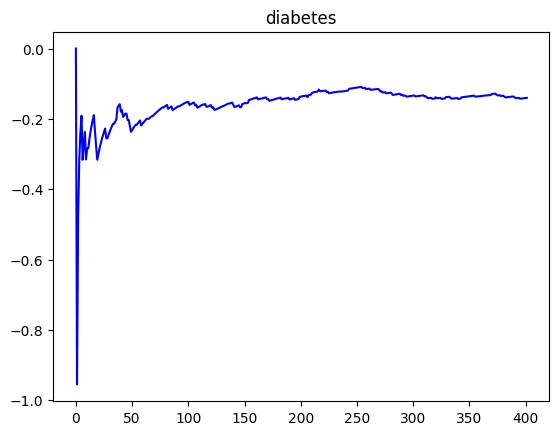

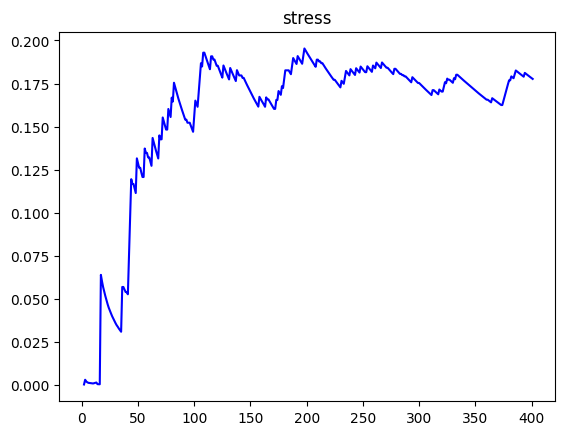

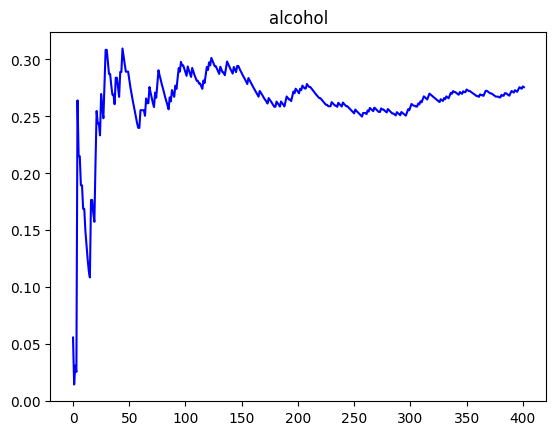

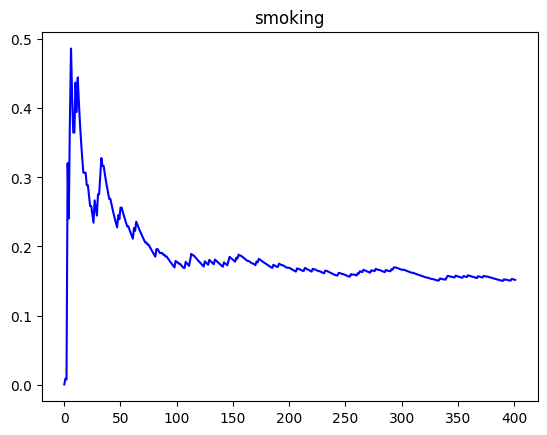

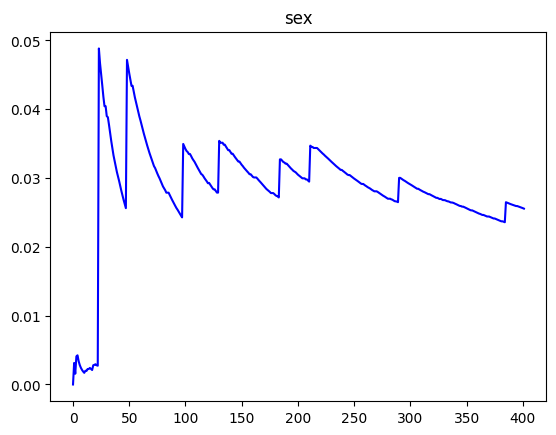

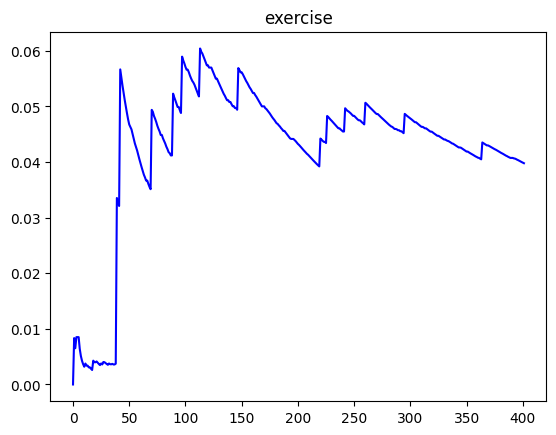

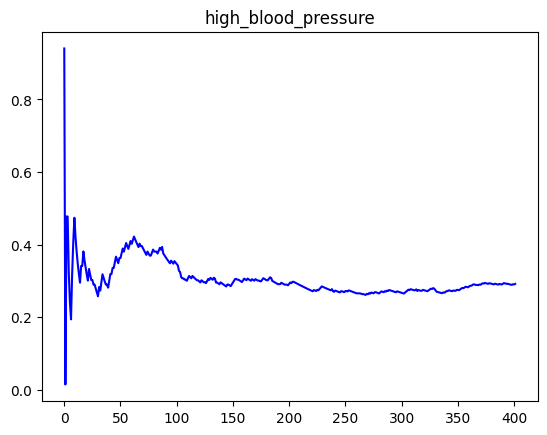

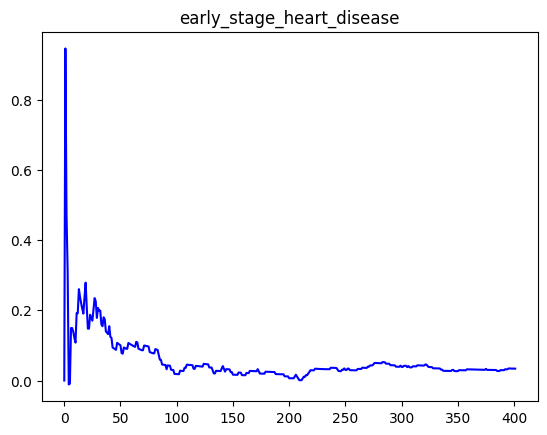

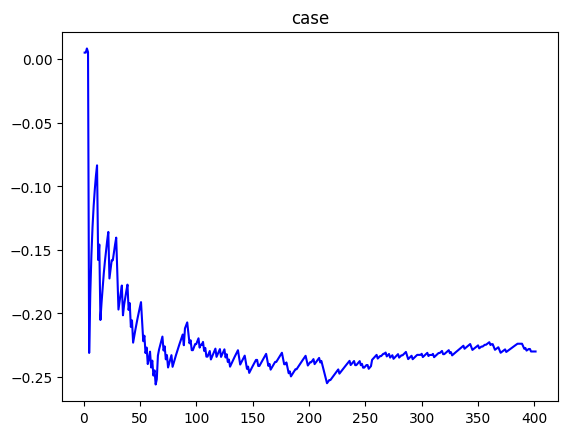

In [477]:
import numpy as np
import matplotlib.pyplot as plt
for item in range(1,sequential_paf_part_dr.shape[0]):
    x_plt = sequential_paf_part_dr.iloc[item:item+1,:].T.reset_index().drop(['index'],axis=1)
    plt.figure()
    plt.plot(x_plt, linestyle='-', color='blue')
    plt.title(list(x_plt.columns)[0])
    name = list(x_plt.columns)[0]
    
    plt.savefig(name+str("_dr.png"))
#     sequential_paf_part.iloc[item:item+1,:].T.reset_index().drop(['index'],axis=1).plot()

In [472]:
print(name)

None


In [475]:
sequential_paf_part

,score,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
name,,,,,,,,,,,,,,,,,,,,,
stress,0.954901,0.000000,0.000000,0.000956,0.003128,0.003180,0.002650,0.002272,0.001988,0.002086,...,0.192962,0.192471,0.191992,0.191513,0.193425,0.192938,0.192465,0.191982,0.191502,0.193406
diabetes,-0.954901,-0.951512,-0.475626,-0.318040,-0.238530,-0.191397,-0.159498,-0.278452,-0.243646,-0.216574,...,-0.090931,-0.090700,-0.090470,-0.090241,-0.090013,-0.089786,-0.089558,-0.089341,-0.091557,-0.093710
sex,0.003128,0.003128,0.001564,0.002086,0.002933,0.003128,0.002607,0.004953,0.004334,0.003852,...,0.143910,0.143544,0.143179,0.142821,0.142488,0.142129,0.141772,0.141416,0.141079,0.140735
high_blood_pressure,0.014859,0.960636,0.950730,0.633820,0.477972,0.570542,0.475582,0.542045,0.475593,0.422749,...,0.251658,0.251044,0.250407,0.252204,0.251593,0.250959,0.250355,0.252085,0.253854,0.253258
case,0.005214,0.000000,-0.000261,-0.000174,-0.000130,0.000417,-0.156413,-0.134068,-0.234880,-0.208782,...,-0.181126,-0.180666,-0.180188,-0.179718,-0.179265,-0.178813,-0.178364,-0.177917,-0.177456,-0.177001
exercise,0.008342,0.006778,0.003389,0.002259,0.001694,0.001356,0.157890,0.275473,0.241039,0.214633,...,0.155261,0.154866,0.154490,0.154115,0.153726,0.155809,0.155418,0.155028,0.157093,0.156722
smoking,0.008603,0.954901,0.480057,0.633559,0.711483,0.569187,0.633472,0.542976,0.593261,0.527981,...,0.265778,0.265102,0.264433,0.263764,0.263098,0.262435,0.261776,0.261125,0.260472,0.259844
early_stage_heart_disease,0.945255,-0.000261,-0.000130,0.000261,-0.001955,-0.001564,-0.001303,-0.001117,-0.000554,-0.000811,...,0.008679,0.008657,0.008628,0.008599,0.008577,0.008555,0.008526,0.008507,0.008490,0.010826
alcohol,0.014599,0.026330,0.040276,0.045273,0.043405,0.045151,0.045012,0.045918,0.162865,0.254866,...,0.253809,0.255681,0.257528,0.256945,0.256372,0.255774,0.257611,0.257113,0.256523,0.255920


In [476]:
sequential_paf_part_dr

,score,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
name,,,,,,,,,,,,,,,,,,,,,
NaN,0.006280,0.962438,0.484359,0.430174,0.568230,0.651064,0.483458,0.457050,0.355597,0.423062,...,0.497990,0.499172,0.498722,0.499991,0.498745,0.499913,0.498673,0.497439,0.496211,0.494989
diabetes,0.000261,-0.954901,-0.477059,-0.318387,-0.238790,-0.191032,-0.316128,-0.270967,-0.237096,-0.315375,...,-0.140868,-0.140466,-0.140069,-0.142491,-0.142090,-0.141686,-0.141290,-0.140887,-0.140496,-0.140106
stress,0.003650,NaN,0.000261,0.002998,0.001999,0.001499,0.001199,0.001130,0.001080,0.000945,...,0.179466,0.178963,0.181169,0.180653,0.180140,0.179650,0.179144,0.178650,0.178158,0.177669
alcohol,0.055787,0.014599,0.031152,0.025634,0.264077,0.215068,0.215068,0.189477,0.189477,0.168851,...,0.270940,0.273015,0.272268,0.271604,0.273637,0.275653,0.275028,0.274278,0.276305,0.275673
smoking,0.000261,0.008603,0.007560,0.320560,0.240420,0.380448,0.486488,0.416989,0.364866,0.364866,...,0.151984,0.151984,0.151536,0.151100,0.150657,0.150657,0.152967,0.152541,0.152112,0.151672
sex,0.000000,0.003128,0.001564,0.004084,0.004236,0.003389,0.002824,0.002421,0.002118,0.001883,...,0.026031,0.025969,0.025926,0.025926,0.025868,0.025813,0.025740,0.025682,0.025621,0.025550
exercise,0.000000,0.008342,0.006517,0.008516,0.008516,0.008516,0.006387,0.005109,0.004258,0.003650,...,0.040664,0.040622,0.040534,0.040418,0.040327,0.040213,0.040099,0.039999,0.039904,0.039792
high_blood_pressure,0.940563,0.014859,0.477711,0.477711,0.323601,0.242701,0.194161,0.318561,0.407418,0.474192,...,0.293241,0.292405,0.292405,0.291610,0.290816,0.289996,0.289180,0.291066,0.290251,0.292068
early_stage_heart_disease,0.000000,0.945255,0.472628,0.311870,-0.011210,-0.008863,0.149418,0.149418,0.138835,0.121481,...,0.032023,0.031937,0.031847,0.034396,0.034312,0.034216,0.034121,0.034029,0.033939,0.033846
